<table align="center">
  <td align="center"><a target="_blank" href="https://colab.research.google.com/github/KhaledElTahan/DeepLearning/blob/master/Labs/lab1/lab1_part2.ipynb">
        <img src="http://introtodeeplearning.com/images/colab/colab.png?v2.0"  style="padding-bottom:5px;" />Run in Google Colab</a></td>
</table>

# Copyright Information

**Parts of this lab are based on Kaggle kernels.**

# Lab 1 - Part2: Logistic Regression

![Logistic Regression](https://raw.githubusercontent.com/KhaledElTahan/AUC-DeepLearning/master/Labs/lab1/logistic_regression.png)

## 1.2.1 Problem Statement

Here, we are trying to increase the peoples’ attention regarding the heart diseases. Like any disease, it is always better to know if you are sick early so you can get the treatment you need before it is too late. Therefore, we use a dataset that gathered some information about two groups: a group with a heart disease and the other group has no disease.
The gathered information includes age, chest pain type, fasting blood sugar, etc. 

Your goal is to train a logistic regression model to predict if a person has a heart disease or not depending on the given information.

## 1.2.2 Problem Details

Let's dive into the code, explain it and show you the parts you need to fill!

### 1.2.2.1 Import Needed packages

Pay close attention to the packages I imported for you.

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam, SGD, Adagrad, RMSprop
from tensorflow.keras.initializers import RandomNormal, RandomUniform
from tensorflow.keras.losses import BinaryCrossentropy, CategoricalHinge
from tensorflow.keras import regularizers

### 1.2.2.2 Work on the dataset

This dataset contains 13 features that demonstrate the health state of a person and our target (0 if this person does not have a heart disease and 1 if he has a heart disease.)

We first load the dataset.

In [2]:
dataset = pd.read_csv("https://raw.githubusercontent.com/KhaledElTahan/DeepLearning/master/Labs/lab1/lab1_heart.csv")

A sneak peak on the dataset and how it looks like.

In [3]:
dataset.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


Define input and output.

In [16]:
X = dataset.iloc[:, 0:13].values
y = dataset.iloc[:, 13].values

**TODO: Preprocess your data**

1.   Do you need to scale the data? Which type of scaling is better? 
2.   Perhaps you might want to add non-linearity by adding artificial features.

![The effect of the boundary with artificial features](https://raw.githubusercontent.com/KhaledElTahan/AUC-DeepLearning/master/Labs/lab1/artificial_features_boundaries.png)

You might have a look on part1 preprocessing and take hints from there. 

**Try different types of data preprocessing and include their effect on the accuracy in your report.**


In [17]:
# TODO: Data Pre-Processing
X_cuib = X ** 3
X =np.concatenate((X, X_cuib), axis = 1)
possible_scaling = [StandardScaler(), MinMaxScaler(), Normalizer()]
scaler = possible_scaling[2]
X = scaler.fit_transform(X)

Split dataset into, training, validation and testing splits.

In [18]:
# Get Training Data
train_X, temporary_X, train_y, temporary_y = train_test_split(X, y, train_size=0.75, random_state=0)

# Get Validation & Testing Data
val_X, test_X, val_y, test_y = train_test_split(temporary_X, temporary_y, train_size=0.5, random_state=0)

### 1.2.2.3 Define your model here (TODO)

Logistic Regression as a model is exactly like the Linear Regression except for the activation function. 

Use this fact to define your model similar to part1 except for the actication function.

![Logistic Regression using Simple Perceptron](https://raw.githubusercontent.com/KhaledElTahan/AUC-DeepLearning/master/Labs/lab1/perceptron_activation.png)

**TODO**: 
1. Try different activation functions and include in the report their effect on the accuracy.
2. Try different regularizers and include in the report their effect on the accuracy.


# For scaling StandardScaler

In [29]:
#try different activation functions and regularizers
Possible_activations = ['sigmoid','relu','tanh']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.7993 - accuracy: 0.2524 - val_loss: 0.7119 - val_accuracy: 0.3684
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7182 - accuracy: 0.4500 - val_loss: 0.6581 - val_accuracy: 0.6316
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6737 - accuracy: 0.5076 - val_loss: 0.6110 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5973 - accuracy: 0.7439

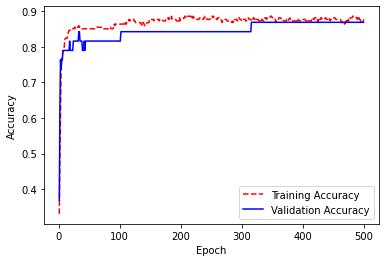

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6582 - accuracy: 0.6821 - val_loss: 0.5582 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5087 - accuracy: 0.8501 - val_loss: 0.4629 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4311 - accuracy: 0.8604 - val_loss: 0.4191 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4233 - accuracy: 0.84

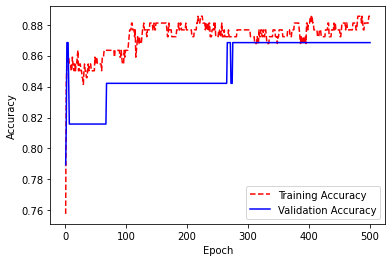

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6083 - accuracy: 0.8105 - val_loss: 0.5481 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4900 - accuracy: 0.8367 - val_loss: 0.4742 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4272 - accuracy: 0.8785 - val_loss: 0.4394 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3700 - accuracy: 0.88

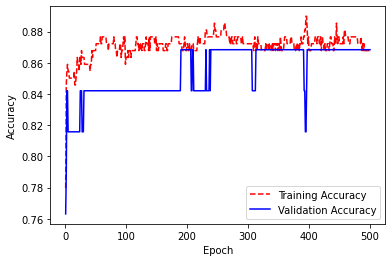

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6530 - accuracy: 0.6018 - val_loss: 0.5054 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4784 - accuracy: 0.8176 - val_loss: 0.4318 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4633 - accuracy: 0.8197 - val_loss: 0.4277 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.4296 - accuracy: 0.85

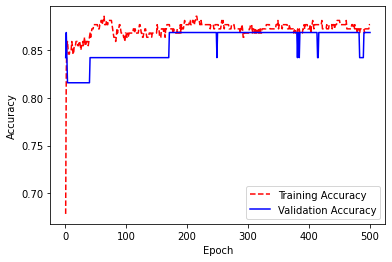

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 5.2821 - accuracy: 0.4381 - val_loss: 1.8559 - val_accuracy: 0.5789
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 2.3113 - accuracy: 0.6173 - val_loss: 0.8194 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.2889 - accuracy: 0.7737 - val_loss: 1.0765 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 1.0578 - accuracy: 0.83

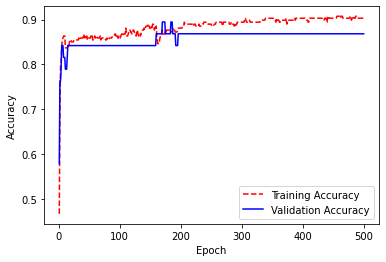

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 3.7963 - accuracy: 0.4913 - val_loss: 1.1409 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.4988 - accuracy: 0.7123 - val_loss: 1.0562 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.3230 - accuracy: 0.7908 - val_loss: 1.0314 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.9482 - accuracy: 0.83

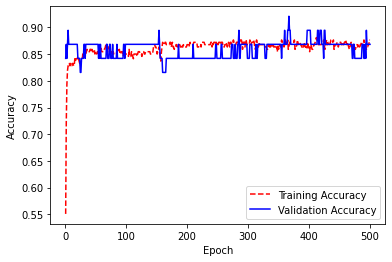

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 5.9694 - accuracy: 0.4006 - val_loss: 1.6563 - val_accuracy: 0.6842
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 2.7691 - accuracy: 0.6276 - val_loss: 1.1860 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.4972 - accuracy: 0.7061 - val_loss: 1.5050 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 1.8742 - accuracy: 0.68

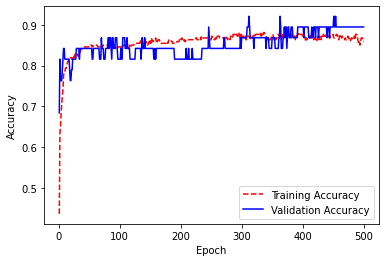

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 2.7757 - accuracy: 0.4294 - val_loss: 1.7958 - val_accuracy: 0.6053
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.5033 - accuracy: 0.6896 - val_loss: 1.6155 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0841 - accuracy: 0.7189 - val_loss: 0.9286 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9406 - accuracy: 0.74

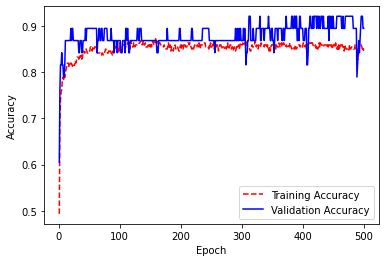

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 3.8468 - accuracy: 0.4400 - val_loss: 2.3592 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 2.6035 - accuracy: 0.4967 - val_loss: 3.1584 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.6053 - accuracy: 0.5387 - val_loss: 3.0388 - val_accuracy: 0.5789
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.2496 - accuracy: 0.68

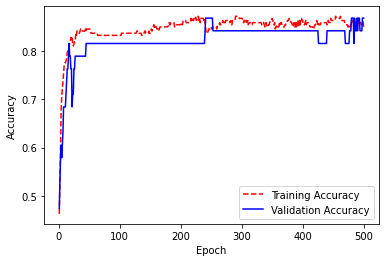

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 2.8974 - accuracy: 0.4672 - val_loss: 0.9328 - val_accuracy: 0.6053
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.3776 - accuracy: 0.6707 - val_loss: 1.1725 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.8051 - accuracy: 0.7205 - val_loss: 1.1300 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7412 - accuracy: 0.81

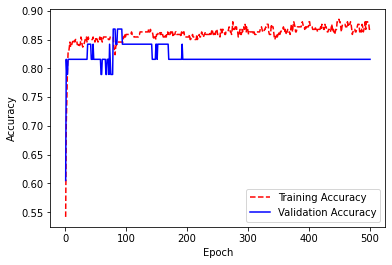

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 3.5862 - accuracy: 0.4770 - val_loss: 1.4695 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.3979 - accuracy: 0.4839 - val_loss: 1.3202 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.2699 - accuracy: 0.4898 - val_loss: 1.2531 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.2627 - accuracy: 0.4

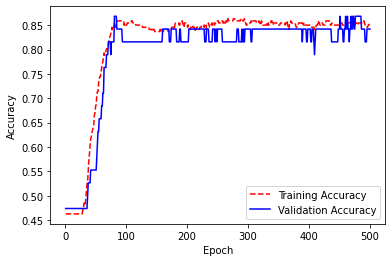

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 4.8319 - accuracy: 0.4723 - val_loss: 1.8588 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.7810 - accuracy: 0.4857 - val_loss: 1.3524 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.4655 - accuracy: 0.4517 - val_loss: 1.2350 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.1323 - accuracy: 0.5

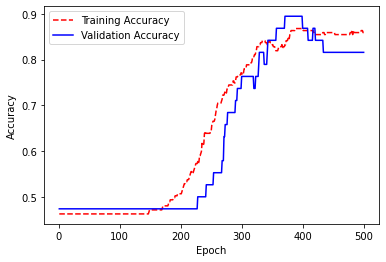

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.3592 - accuracy: 0.8734 - val_loss: 0.3731 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3577 - accuracy: 0.8311 - val_loss: 0.3744 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3047 - accuracy: 0.8927 - val_loss: 0.3825 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3219 - accuracy: 0.8622

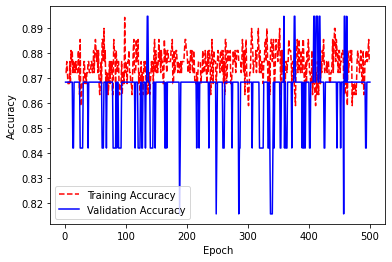

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.3150 - accuracy: 0.8704 - val_loss: 0.3759 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3575 - accuracy: 0.8787 - val_loss: 0.3753 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2452 - accuracy: 0.9314 - val_loss: 0.3993 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.2953 - accuracy: 0.88

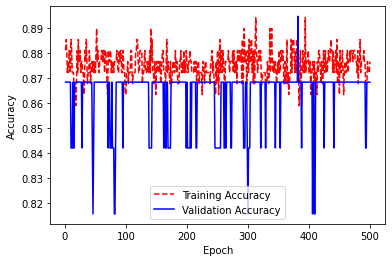

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3838 - accuracy: 0.8339 - val_loss: 0.3781 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 20ms/step - loss: 0.3100 - accuracy: 0.8947 - val_loss: 0.3834 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3226 - accuracy: 0.9005 - val_loss: 0.3846 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3308 - accuracy: 0.8

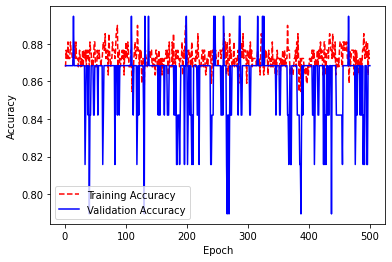

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3953 - accuracy: 0.8520 - val_loss: 0.3856 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3304 - accuracy: 0.8960 - val_loss: 0.3797 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3551 - accuracy: 0.8732 - val_loss: 0.3844 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2756 - accuracy: 0.89

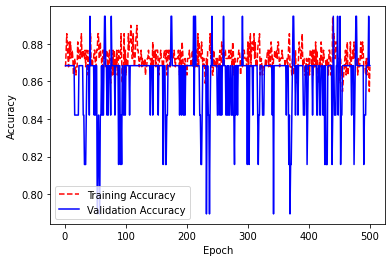

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.9875 - accuracy: 0.9015 - val_loss: 0.9961 - val_accuracy: 0.8947
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 1.1861 - accuracy: 0.8900 - val_loss: 0.9242 - val_accuracy: 0.8947
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8135 - accuracy: 0.8805 - val_loss: 1.3222 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.2240 - accuracy: 0.86

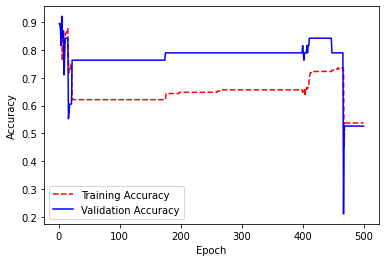

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6695 - accuracy: 0.8551 - val_loss: 0.9653 - val_accuracy: 0.8947
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7864 - accuracy: 0.8607 - val_loss: 3.7380 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 3.6699 - accuracy: 0.6853 - val_loss: 2.2750 - val_accuracy: 0.6842
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.8822 - accuracy: 0.78

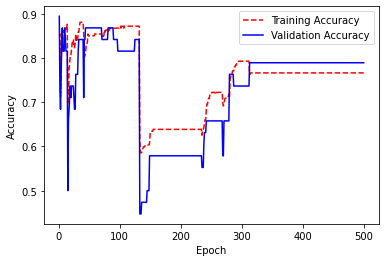

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.4777 - accuracy: 0.8157 - val_loss: 0.6239 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8924 - accuracy: 0.8329 - val_loss: 1.3776 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8465 - accuracy: 0.8474 - val_loss: 0.3517 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6373 - accuracy: 0.87

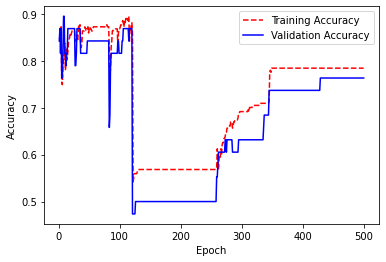

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.5856 - accuracy: 0.8551 - val_loss: 3.1377 - val_accuracy: 0.6579
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 3.4836 - accuracy: 0.6292 - val_loss: 1.0167 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 2.5814 - accuracy: 0.7672 - val_loss: 0.7337 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 2.2423 - accuracy: 0.82

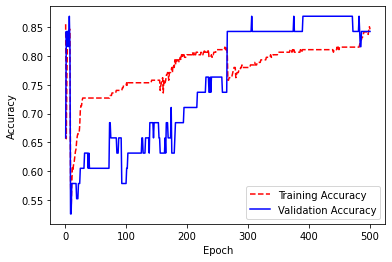

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6454 - accuracy: 0.8543 - val_loss: 0.7236 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5156 - accuracy: 0.8786 - val_loss: 0.7355 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7178 - accuracy: 0.8840 - val_loss: 0.7111 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4607 - accuracy: 0.87

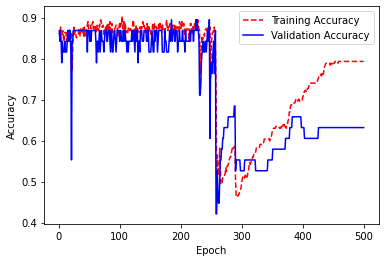

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.8338 - accuracy: 0.8335 - val_loss: 0.6792 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6604 - accuracy: 0.8826 - val_loss: 1.0692 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9720 - accuracy: 0.8104 - val_loss: 0.7513 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.84

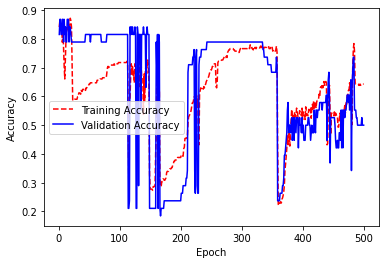

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3752 - accuracy: 0.8395 - val_loss: 0.7949 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3850 - accuracy: 0.8767 - val_loss: 0.7855 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4234 - accuracy: 0.8498 - val_loss: 0.7740 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3162 - accuracy: 0.8

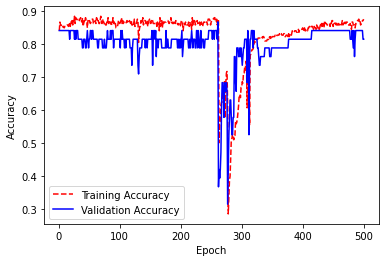

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 34ms/step - loss: 0.3954 - accuracy: 0.8643 - val_loss: 0.4476 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4007 - accuracy: 0.8477 - val_loss: 0.4537 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3873 - accuracy: 0.8565 - val_loss: 0.4446 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.4146 - accuracy: 0.7

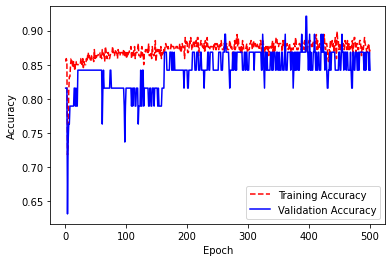

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.3316 - accuracy: 0.8819 - val_loss: 0.3777 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2742 - accuracy: 0.8920 - val_loss: 0.3800 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2701 - accuracy: 0.8968 - val_loss: 0.3806 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3378 - accuracy: 0.8657

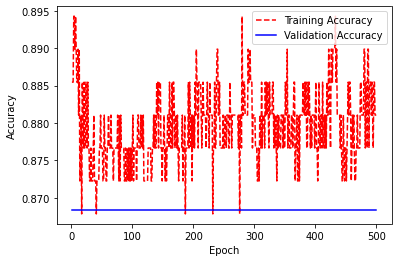

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 25ms/step - loss: 0.3034 - accuracy: 0.8776 - val_loss: 0.3744 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3061 - accuracy: 0.8628 - val_loss: 0.3771 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3772 - accuracy: 0.8483 - val_loss: 0.3762 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2709 - accuracy: 0.88

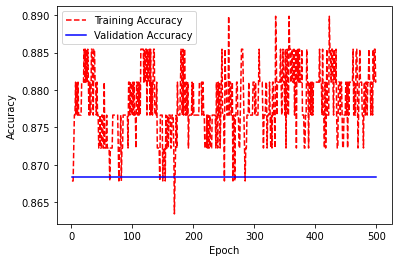

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.3951 - accuracy: 0.8496 - val_loss: 0.3909 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3271 - accuracy: 0.8639 - val_loss: 0.3918 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3331 - accuracy: 0.8576 - val_loss: 0.3924 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 9ms/step - loss: 0.3073 - accuracy: 0.88

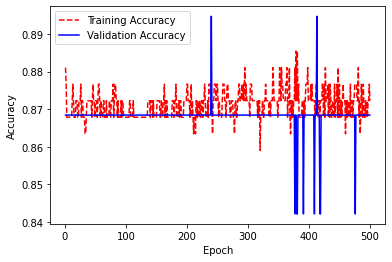

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.3444 - accuracy: 0.8663 - val_loss: 0.3765 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3168 - accuracy: 0.8830 - val_loss: 0.3823 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3413 - accuracy: 0.8593 - val_loss: 0.3819 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.3221 - accuracy: 0.86

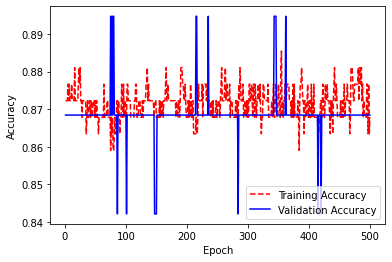

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 7.5951 - accuracy: 0.5290 - val_loss: 7.6274 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 7.9004 - accuracy: 0.5083 - val_loss: 7.6187 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 7.1133 - accuracy: 0.5593 - val_loss: 7.6106 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 7.7144 - accuracy: 0.51

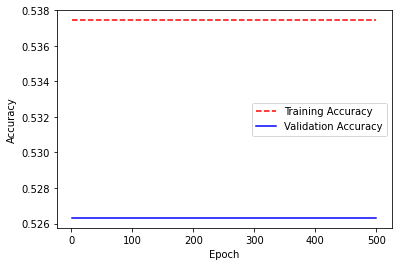

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 4.2961 - accuracy: 0.7451 - val_loss: 3.6121 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 3.9315 - accuracy: 0.7685 - val_loss: 3.6042 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 8ms/step - loss: 3.9928 - accuracy: 0.7639 - val_loss: 3.5969 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 4.6619 - accuracy: 0.71

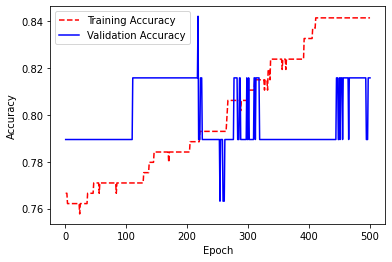

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 3.8657 - accuracy: 0.7660 - val_loss: 3.9226 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 3.5704 - accuracy: 0.7794 - val_loss: 3.9225 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 3.2375 - accuracy: 0.8045 - val_loss: 3.9223 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 3.5988 - accuracy: 0.78

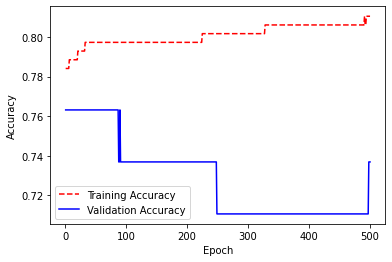

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 2.2857 - accuracy: 0.8558 - val_loss: 1.8264 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 2.3142 - accuracy: 0.8542 - val_loss: 1.8268 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 2.4729 - accuracy: 0.8449 - val_loss: 1.8258 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 2.2741 - accuracy: 0.84

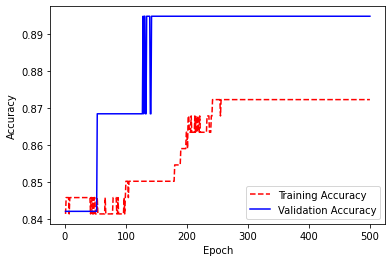

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 48ms/step - loss: 3.5635 - accuracy: 0.7866 - val_loss: 5.4997 - val_accuracy: 0.6316
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 3.4018 - accuracy: 0.7971 - val_loss: 5.4898 - val_accuracy: 0.6316
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 3.2792 - accuracy: 0.8048 - val_loss: 5.4824 - val_accuracy: 0.6316
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 3.4399 - accuracy: 0.79

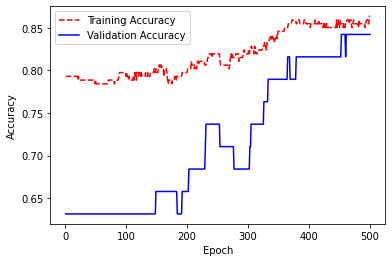

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 67.0074 - accuracy: 0.6103 - val_loss: 68.3148 - val_accuracy: 0.5000
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 65.8091 - accuracy: 0.6795 - val_loss: 68.2103 - val_accuracy: 0.5000
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 66.4493 - accuracy: 0.6330 - val_loss: 68.1183 - val_accuracy: 0.5000
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 66.3465 - accurac

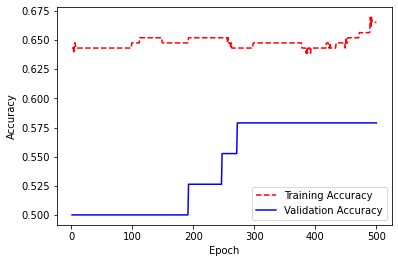

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.2771 - accuracy: 0.8942 - val_loss: 0.7534 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 9ms/step - loss: 0.3905 - accuracy: 0.8777 - val_loss: 0.7514 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 8ms/step - loss: 0.3504 - accuracy: 0.8542 - val_loss: 0.7526 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3671 - accuracy: 0.8

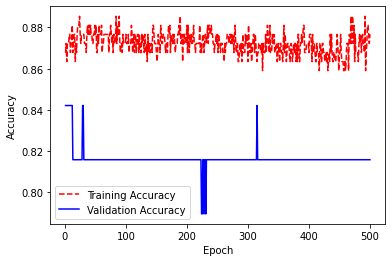

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.3969 - accuracy: 0.8895 - val_loss: 0.7115 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3800 - accuracy: 0.8927 - val_loss: 0.7075 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5423 - accuracy: 0.8931 - val_loss: 0.7018 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3307 - accuracy: 0.9

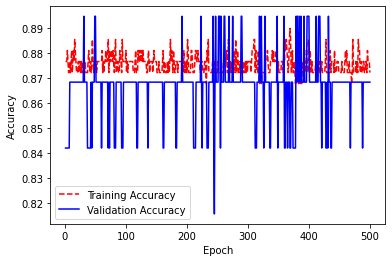

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.6662 - accuracy: 0.8839 - val_loss: 0.6977 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6837 - accuracy: 0.8667 - val_loss: 0.6917 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6401 - accuracy: 0.8720 - val_loss: 0.6883 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.5803 - accuracy: 0.8843

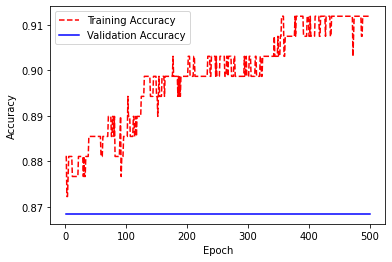

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6459 - accuracy: 0.8947 - val_loss: 0.6938 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6536 - accuracy: 0.8808 - val_loss: 0.6909 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6625 - accuracy: 0.8487 - val_loss: 0.6877 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6653 - accuracy: 0.88

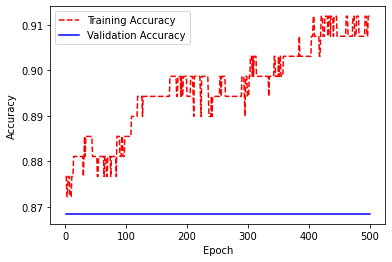

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.6716 - accuracy: 0.8861 - val_loss: 0.7127 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6990 - accuracy: 0.8902 - val_loss: 0.7081 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6436 - accuracy: 0.8922 - val_loss: 0.7028 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6135 - accuracy: 0.86

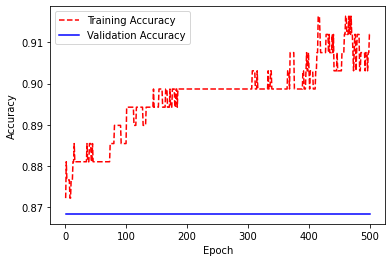

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6658 - accuracy: 0.9103 - val_loss: 0.7177 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7175 - accuracy: 0.8640 - val_loss: 0.7122 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6644 - accuracy: 0.8859 - val_loss: 0.7071 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6496 - accuracy: 0.87

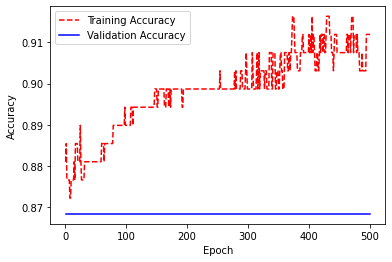

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 2.0769 - accuracy: 0.5306 - val_loss: 2.0920 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.9266 - accuracy: 0.5633 - val_loss: 2.0840 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 2.0715 - accuracy: 0.5287 - val_loss: 2.0754 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 2.2477 - accuracy: 0.48

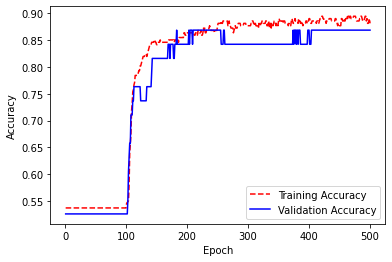

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.9269 - accuracy: 0.8601 - val_loss: 0.8001 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0413 - accuracy: 0.8070 - val_loss: 0.7665 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7549 - accuracy: 0.8435 - val_loss: 0.7340 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8824 - accuracy: 0.83

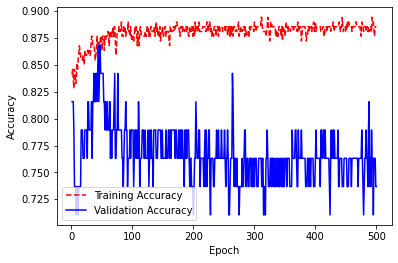

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 2.0898 - accuracy: 0.8038 - val_loss: 1.8516 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 2.4549 - accuracy: 0.7637 - val_loss: 1.8307 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.8906 - accuracy: 0.8094 - val_loss: 1.8123 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 2.0998 - accuracy: 0.78

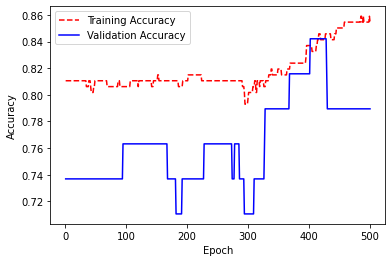

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 51ms/step - loss: 0.9735 - accuracy: 0.8643 - val_loss: 0.7401 - val_accuracy: 0.8947
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0029 - accuracy: 0.8610 - val_loss: 0.7385 - val_accuracy: 0.8947
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.1936 - accuracy: 0.8414 - val_loss: 0.7363 - val_accuracy: 0.8947
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8728 - accuracy: 0.88

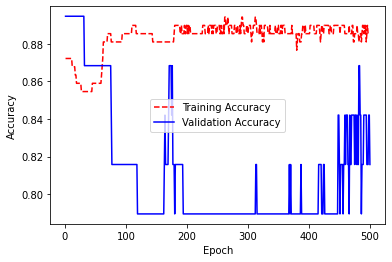

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.4917 - accuracy: 0.8642 - val_loss: 0.5621 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4622 - accuracy: 0.8769 - val_loss: 0.5381 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.8700 - val_loss: 0.5186 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.83

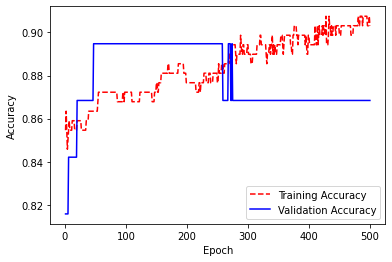

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 22.9221 - accuracy: 0.6638 - val_loss: 23.0795 - val_accuracy: 0.5789
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 23.0045 - accuracy: 0.6214 - val_loss: 23.0581 - val_accuracy: 0.5789
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 22.8735 - accuracy: 0.6716 - val_loss: 23.0302 - val_accuracy: 0.5789
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 22.8225 - accurac

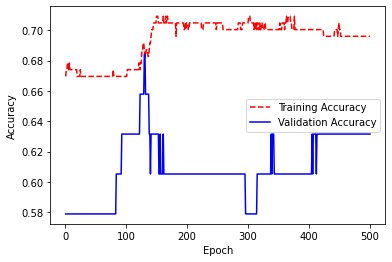

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.5091 - accuracy: 0.8714 - val_loss: 0.5593 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4675 - accuracy: 0.8836 - val_loss: 0.5293 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4372 - accuracy: 0.8910 - val_loss: 0.5089 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4397 - accuracy: 0.8

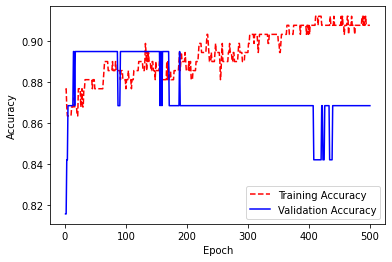

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.3947 - accuracy: 0.8758 - val_loss: 0.4435 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4115 - accuracy: 0.8785 - val_loss: 0.4300 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3607 - accuracy: 0.8976 - val_loss: 0.4177 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3537 - accuracy: 0.8

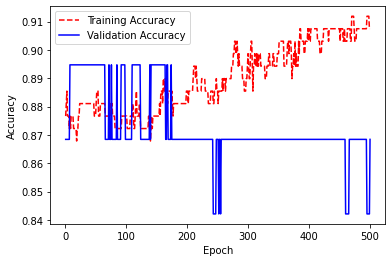

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5572 - accuracy: 0.9177 - val_loss: 0.6283 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5775 - accuracy: 0.9120 - val_loss: 0.6279 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5901 - accuracy: 0.8879 - val_loss: 0.6281 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6201 - accuracy: 0.9080

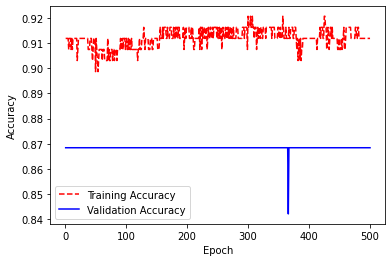

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6001 - accuracy: 0.8991 - val_loss: 0.6295 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5876 - accuracy: 0.9198 - val_loss: 0.6275 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5642 - accuracy: 0.9381 - val_loss: 0.6279 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5930 - accuracy: 0.90

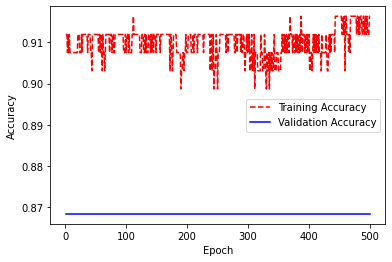

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6049 - accuracy: 0.9049 - val_loss: 0.6532 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5905 - accuracy: 0.9276 - val_loss: 0.6530 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6356 - accuracy: 0.9212 - val_loss: 0.6505 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5818 - accuracy: 0.93

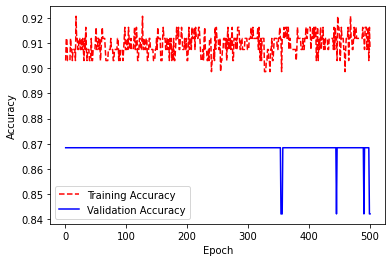

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.6288 - accuracy: 0.9129 - val_loss: 0.6496 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5518 - accuracy: 0.9214 - val_loss: 0.6503 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6183 - accuracy: 0.9128 - val_loss: 0.6499 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5760 - accuracy: 0.90

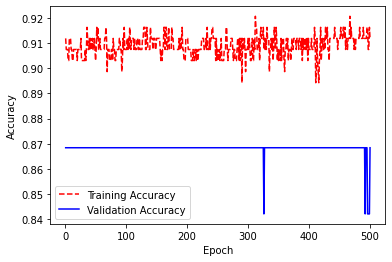

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.6011 - accuracy: 0.8909 - val_loss: 0.6317 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6257 - accuracy: 0.9074 - val_loss: 0.6200 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6566 - accuracy: 0.8690 - val_loss: 0.6267 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5718 - accuracy: 0.89

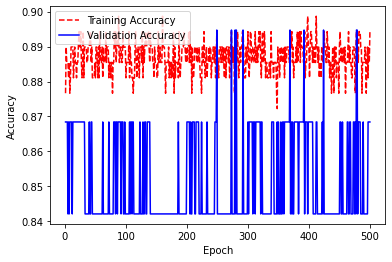

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.6395 - accuracy: 0.8537 - val_loss: 0.6393 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6874 - accuracy: 0.8099 - val_loss: 0.6780 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6446 - accuracy: 0.8362 - val_loss: 0.6459 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6548 - accuracy: 0.87

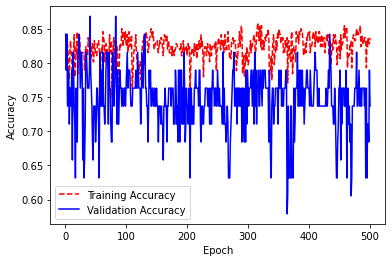

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.7421 - accuracy: 0.8248 - val_loss: 0.7224 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7253 - accuracy: 0.8199 - val_loss: 0.7201 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6279 - accuracy: 0.8538 - val_loss: 0.7186 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6628 - accuracy: 0.84

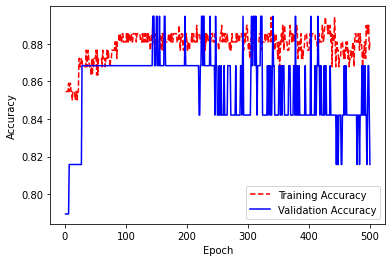

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 25ms/step - loss: 0.5936 - accuracy: 0.9181 - val_loss: 0.6504 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6707 - accuracy: 0.8897 - val_loss: 0.6631 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6604 - accuracy: 0.8857 - val_loss: 0.6841 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6469 - accuracy: 0.86

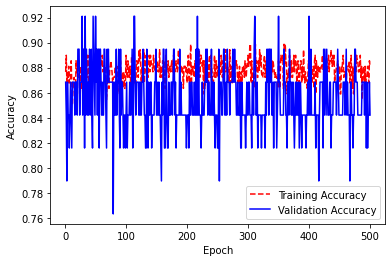

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.2429 - accuracy: 0.9107 - val_loss: 0.3025 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 1s 40ms/step - loss: 0.2315 - accuracy: 0.9074 - val_loss: 0.3032 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2172 - accuracy: 0.9041 - val_loss: 0.3040 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2142 - accuracy: 0.9

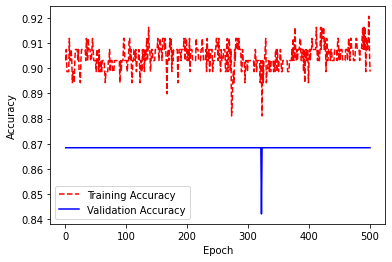

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 7.6468 - accuracy: 0.7065 - val_loss: 7.8043 - val_accuracy: 0.6316
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 7.6523 - accuracy: 0.6878 - val_loss: 7.7597 - val_accuracy: 0.6316
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 7.5721 - accuracy: 0.7023 - val_loss: 7.7221 - val_accuracy: 0.6316
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 7.4206 - accuracy: 0.76

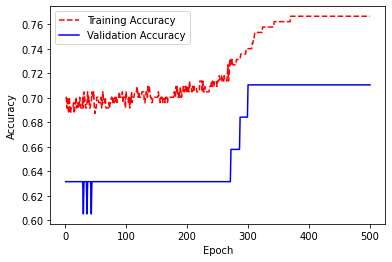

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.2302 - accuracy: 0.9130 - val_loss: 0.3264 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2558 - accuracy: 0.9083 - val_loss: 0.3230 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2539 - accuracy: 0.9136 - val_loss: 0.3296 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3306 - accuracy: 0.8

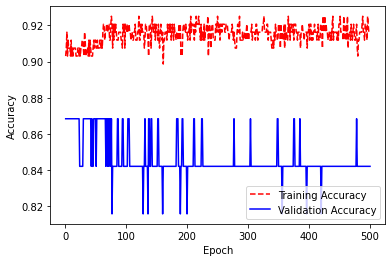

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.3105 - accuracy: 0.8772 - val_loss: 0.3361 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2353 - accuracy: 0.9215 - val_loss: 0.3371 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2418 - accuracy: 0.9270 - val_loss: 0.3373 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2168 - accuracy: 0.9

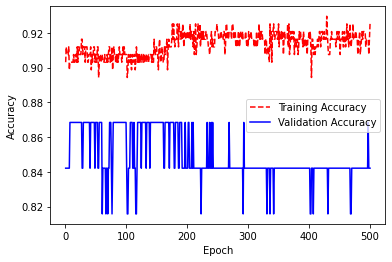

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5486 - accuracy: 0.9216 - val_loss: 0.6322 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.9431 - val_loss: 0.6319 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5845 - accuracy: 0.9091 - val_loss: 0.6318 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6143 - accuracy: 0.8992

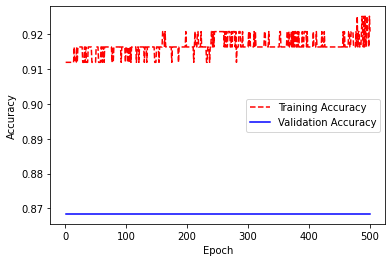

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.5820 - accuracy: 0.9134 - val_loss: 0.6319 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6172 - accuracy: 0.8775 - val_loss: 0.6327 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5931 - accuracy: 0.8946 - val_loss: 0.6325 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5586 - accuracy: 0.91

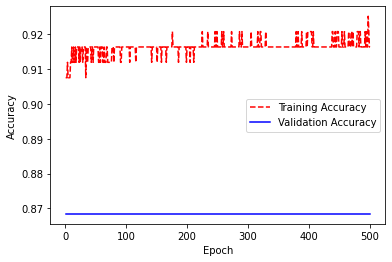

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.5835 - accuracy: 0.9208 - val_loss: 0.6638 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6603 - accuracy: 0.8895 - val_loss: 0.6644 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6449 - accuracy: 0.9210 - val_loss: 0.6631 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6312 - accuracy: 0.90

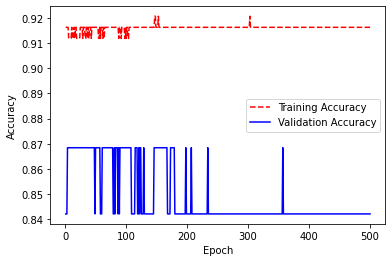

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6116 - accuracy: 0.9066 - val_loss: 0.6569 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5718 - accuracy: 0.9343 - val_loss: 0.6580 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6128 - accuracy: 0.9065 - val_loss: 0.6591 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5904 - accuracy: 0.92

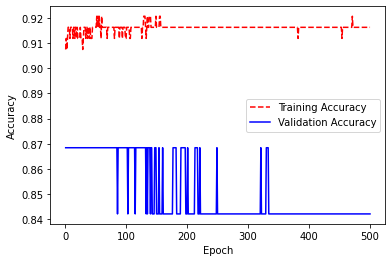

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.5813 - accuracy: 0.9051 - val_loss: 0.6250 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5428 - accuracy: 0.9147 - val_loss: 0.6259 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6537 - accuracy: 0.8643 - val_loss: 0.6267 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5969 - accuracy: 0.86

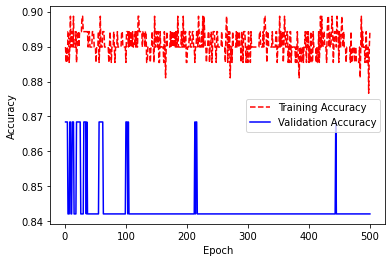

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.7039 - accuracy: 0.8460 - val_loss: 0.7493 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6191 - accuracy: 0.8653 - val_loss: 0.7488 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6285 - accuracy: 0.8210 - val_loss: 0.7466 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6043 - accuracy: 0.86

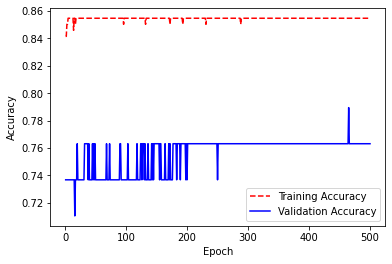

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.6323 - accuracy: 0.8882 - val_loss: 0.6560 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6141 - accuracy: 0.9077 - val_loss: 0.6558 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6233 - accuracy: 0.8886 - val_loss: 0.6544 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6370 - accuracy: 0.87

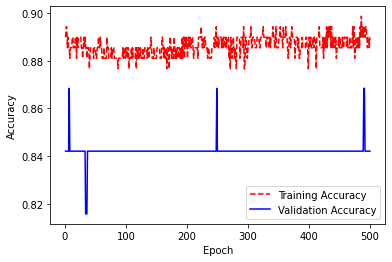

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5940 - accuracy: 0.9008 - val_loss: 0.6595 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5912 - accuracy: 0.8944 - val_loss: 0.6559 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.5340 - accuracy: 0.9111 - val_loss: 0.6501 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6089 - accuracy: 0.86

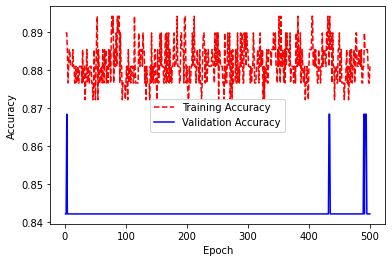

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.2449 - accuracy: 0.9024 - val_loss: 0.2954 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2667 - accuracy: 0.8890 - val_loss: 0.2950 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2256 - accuracy: 0.9138 - val_loss: 0.2943 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2141 - accuracy: 0.92

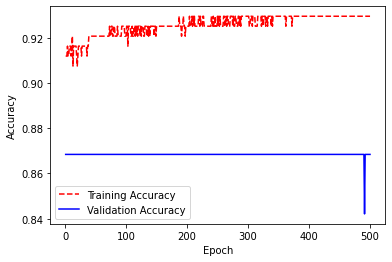

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8055 - accuracy: 0.7856 - val_loss: 1.0188 - val_accuracy: 0.7105
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.7806 - accuracy: 0.8002 - val_loss: 1.0179 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8471 - accuracy: 0.7636 - val_loss: 1.0169 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7656 - accuracy: 0.80

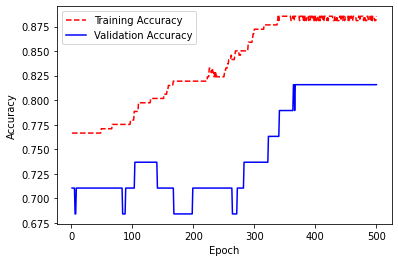

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 2s 60ms/step - loss: 0.2316 - accuracy: 0.9213 - val_loss: 0.3421 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2232 - accuracy: 0.9246 - val_loss: 0.3381 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2386 - accuracy: 0.9196 - val_loss: 0.3402 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3233 - accuracy: 0.8

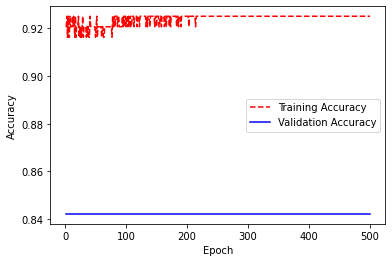

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.2635 - accuracy: 0.9098 - val_loss: 0.3448 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2097 - accuracy: 0.9296 - val_loss: 0.3462 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2461 - accuracy: 0.9193 - val_loss: 0.3468 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2540 - accuracy: 0.9

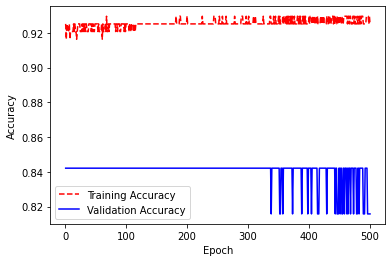

In [15]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [16]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.34
Test fraction correct (NN-Accuracy) = 0.87


**Softmax**

In [7]:
#try different activation functions and regularizers
Possible_activations = ['softmax']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 38ms/step - loss: 0.6913 - accuracy: 0.5128 - val_loss: 0.6895 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6855 - accuracy: 0.5349 - val_loss: 0.6825 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6779 - accuracy: 0.5147 - val_loss: 0.6736 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6639 - accuracy: 0.5361

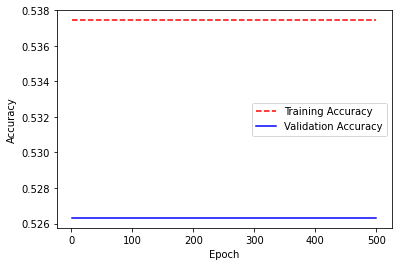

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6831 - accuracy: 0.5567 - val_loss: 0.5658 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5437 - accuracy: 0.5402 - val_loss: 0.4680 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.5189 - val_loss: 0.4277 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4216 - accuracy: 0.55

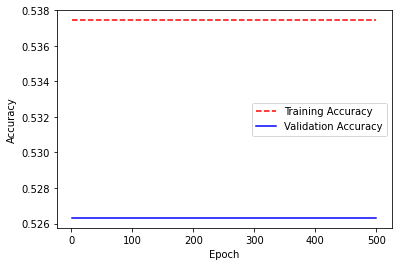

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6987 - accuracy: 0.5196 - val_loss: 0.6806 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6692 - accuracy: 0.5603 - val_loss: 0.6383 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6226 - accuracy: 0.5270 - val_loss: 0.5796 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5480 - accuracy: 0.54

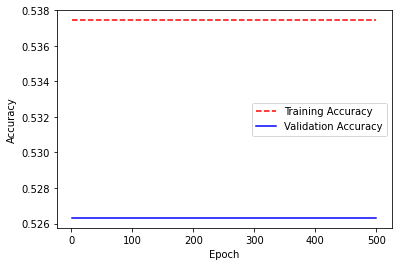

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6425 - accuracy: 0.5263 - val_loss: 0.4660 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4574 - accuracy: 0.4913 - val_loss: 0.4196 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3820 - accuracy: 0.4826 - val_loss: 0.4143 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3872 - accuracy: 0.52

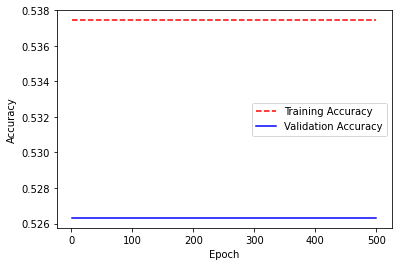

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3112 - accuracy: 0.5478 - val_loss: 0.3890 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3442 - accuracy: 0.5700 - val_loss: 0.3905 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3482 - accuracy: 0.4862 - val_loss: 0.3892 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3470 - accuracy: 0.5427

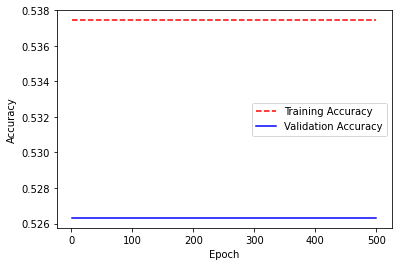

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3065 - accuracy: 0.5323 - val_loss: 0.4043 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3222 - accuracy: 0.5196 - val_loss: 0.4017 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2918 - accuracy: 0.5726 - val_loss: 0.3965 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3055 - accuracy: 0.54

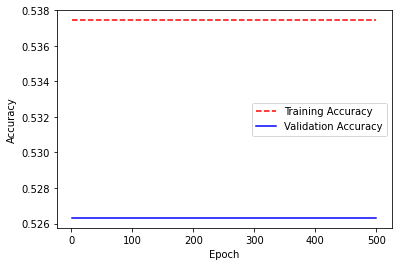

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3225 - accuracy: 0.5566 - val_loss: 0.3992 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3707 - accuracy: 0.5431 - val_loss: 0.3962 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3610 - accuracy: 0.5284 - val_loss: 0.3952 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3304 - accuracy: 0.56

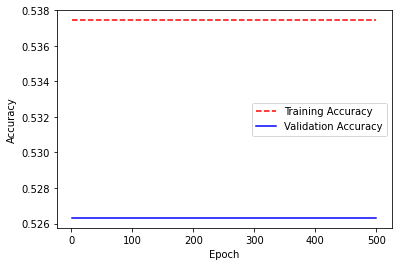

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.2914 - accuracy: 0.5428 - val_loss: 0.3921 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3329 - accuracy: 0.5405 - val_loss: 0.3894 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3262 - accuracy: 0.5477 - val_loss: 0.3895 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3729 - accuracy: 0.51

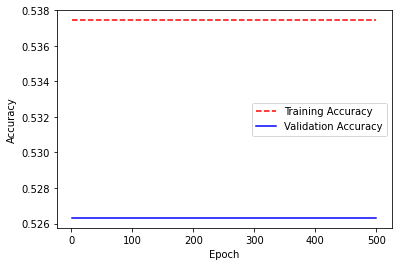

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 32ms/step - loss: 0.2492 - accuracy: 0.5163 - val_loss: 0.3839 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2816 - accuracy: 0.5478 - val_loss: 0.3831 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2982 - accuracy: 0.5078 - val_loss: 0.3842 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2924 - accuracy: 0.5347

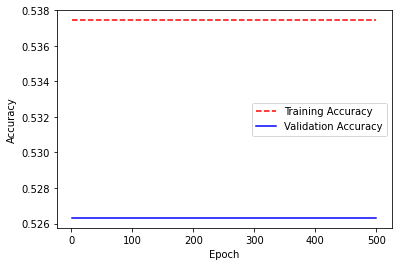

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3192 - accuracy: 0.4945 - val_loss: 0.3936 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3516 - accuracy: 0.5691 - val_loss: 0.3923 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2895 - accuracy: 0.5344 - val_loss: 0.3888 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2820 - accuracy: 0.57

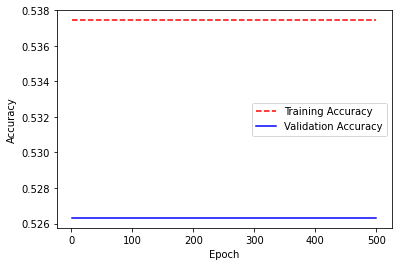

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3202 - accuracy: 0.5237 - val_loss: 0.3991 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2795 - accuracy: 0.5167 - val_loss: 0.3969 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3532 - accuracy: 0.5826 - val_loss: 0.3962 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2986 - accuracy: 0.53

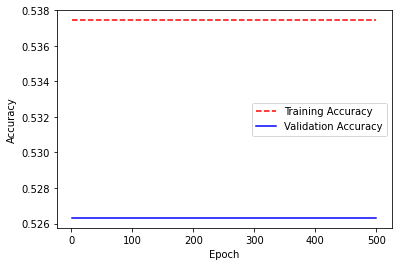

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.3177 - accuracy: 0.5388 - val_loss: 0.3638 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3824 - accuracy: 0.5211 - val_loss: 0.3656 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3506 - accuracy: 0.5457 - val_loss: 0.3712 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3392 - accuracy: 0.50

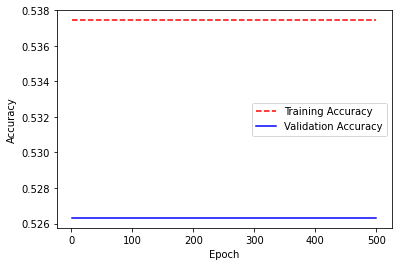

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 1.0024 - accuracy: 0.5031 - val_loss: 0.9561 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9028 - accuracy: 0.5530 - val_loss: 0.9560 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8860 - accuracy: 0.5613 - val_loss: 0.9560 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8743 - accuracy: 0.5672

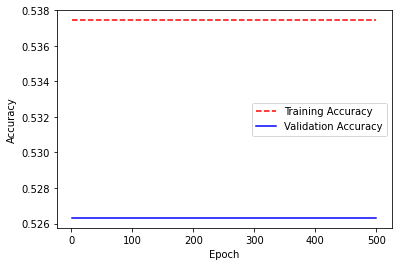

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.8360 - accuracy: 0.5861 - val_loss: 0.9556 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0498 - accuracy: 0.4792 - val_loss: 0.9556 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9680 - accuracy: 0.5201 - val_loss: 0.9555 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9066 - accuracy: 0.55

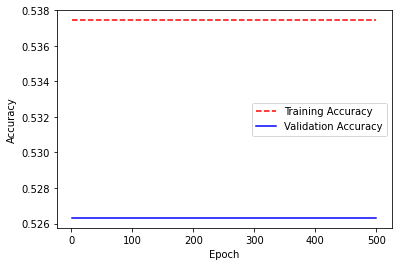

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9475 - accuracy: 0.5379 - val_loss: 0.9707 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0108 - accuracy: 0.5063 - val_loss: 0.9705 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9927 - accuracy: 0.5152 - val_loss: 0.9703 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9322 - accuracy: 0.54

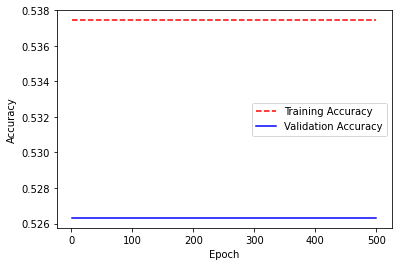

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 35ms/step - loss: 0.8438 - accuracy: 0.5887 - val_loss: 0.9686 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9947 - accuracy: 0.5133 - val_loss: 0.9685 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9134 - accuracy: 0.5538 - val_loss: 0.9684 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9258 - accuracy: 0.54

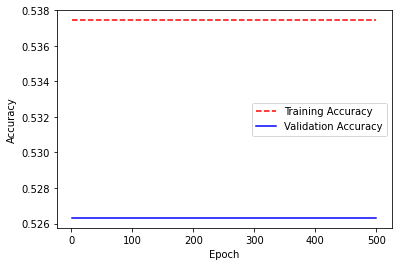

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9534 - accuracy: 0.5233 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9638 - accuracy: 0.5181 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9522 - accuracy: 0.5239 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9339 - accuracy: 0.5331

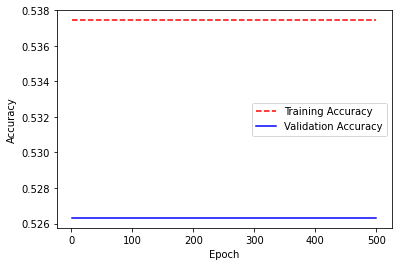

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.9498 - accuracy: 0.5251 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8147 - accuracy: 0.5927 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8623 - accuracy: 0.5689 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8777 - accuracy: 0.56

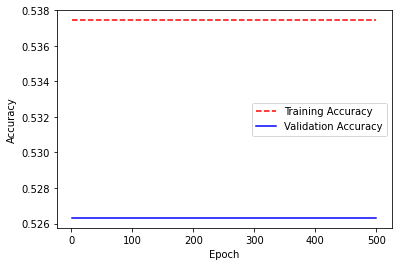

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.8073 - accuracy: 0.5964 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9721 - accuracy: 0.5140 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9275 - accuracy: 0.5363 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9661 - accuracy: 0.51

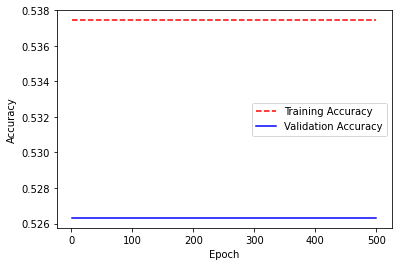

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.8877 - accuracy: 0.5561 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0435 - accuracy: 0.4783 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9708 - accuracy: 0.5146 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9897 - accuracy: 0.50

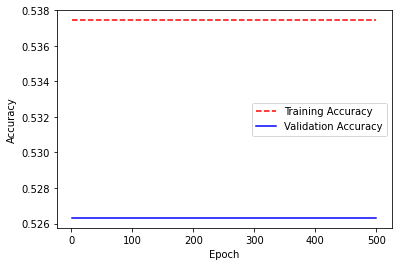

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9257 - accuracy: 0.5371 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0500 - accuracy: 0.4750 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9146 - accuracy: 0.5427 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9304 - accuracy: 0.5348

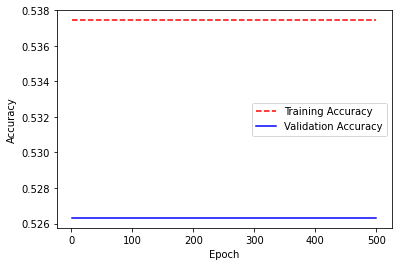

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9878 - accuracy: 0.5061 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8843 - accuracy: 0.5579 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9409 - accuracy: 0.5295 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9276 - accuracy: 0.53

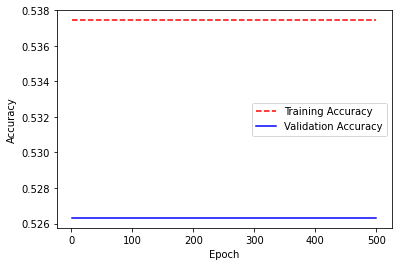

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.8918 - accuracy: 0.5541 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9300 - accuracy: 0.5350 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8963 - accuracy: 0.5519 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0295 - accuracy: 0.48

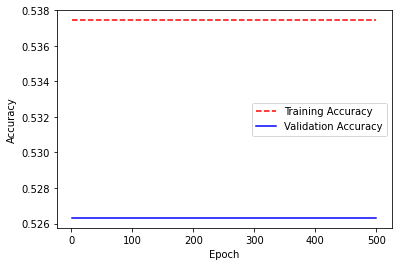

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9042 - accuracy: 0.5479 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9532 - accuracy: 0.5234 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9225 - accuracy: 0.5388 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0268 - accuracy: 0.48

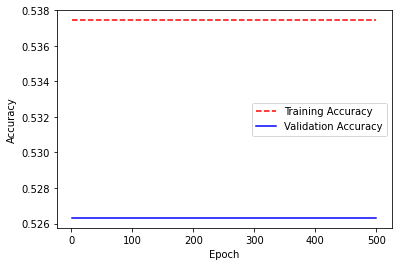

In [8]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [9]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.79
Test fraction correct (NN-Accuracy) = 0.61


# For scaling MinMaxdScaler

In [ ]:
#try different activation functions and regularizers
Possible_activations = ['sigmoid','relu','tanh']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6947 - accuracy: 0.5184 - val_loss: 0.6847 - val_accuracy: 0.6579
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6869 - accuracy: 0.5929 - val_loss: 0.6802 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 3ms/step - loss: 0.6848 - accuracy: 0.6574 - val_loss: 0.6756 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6783 - accuracy: 0.7

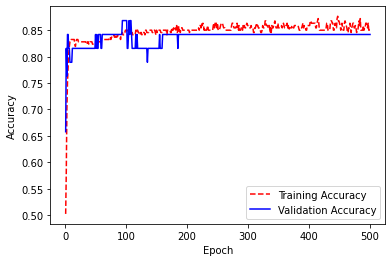

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6911 - accuracy: 0.5223 - val_loss: 0.6763 - val_accuracy: 0.7105
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6611 - accuracy: 0.8201 - val_loss: 0.6550 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6360 - accuracy: 0.8006 - val_loss: 0.6321 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6057 - accuracy: 0.8

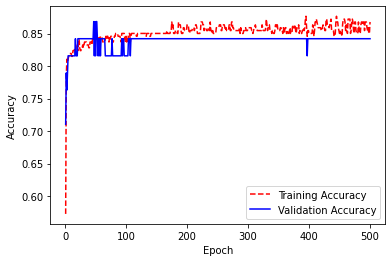

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6976 - accuracy: 0.5904 - val_loss: 0.6621 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6402 - accuracy: 0.8426 - val_loss: 0.6282 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6131 - accuracy: 0.8001 - val_loss: 0.6033 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5754 - accuracy: 0.8

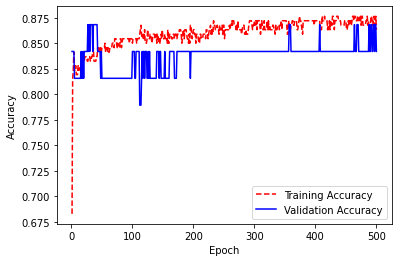

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6919 - accuracy: 0.5993 - val_loss: 0.6836 - val_accuracy: 0.6579
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6831 - accuracy: 0.6821 - val_loss: 0.6722 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6595 - accuracy: 0.7701 - val_loss: 0.6543 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6314 - accuracy: 0.8

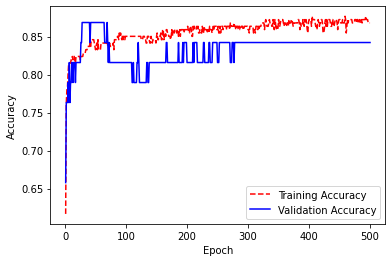

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.7078 - accuracy: 0.5899 - val_loss: 0.5047 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5294 - accuracy: 0.7403 - val_loss: 0.4359 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4479 - accuracy: 0.8125 - val_loss: 0.4077 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4174 - accuracy: 0.8

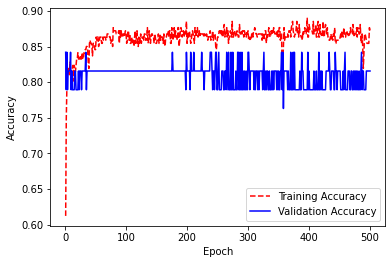

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 2.4250 - accuracy: 0.4663 - val_loss: 1.1090 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.0622 - accuracy: 0.4705 - val_loss: 0.8820 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8975 - accuracy: 0.4615 - val_loss: 0.7999 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.8081 - accuracy: 0.4

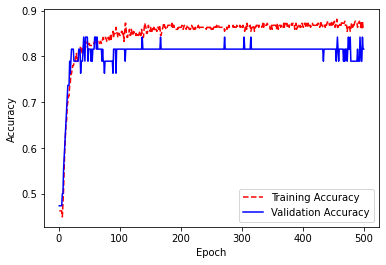

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 1.0397 - accuracy: 0.4189 - val_loss: 0.7045 - val_accuracy: 0.5789
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7190 - accuracy: 0.5459 - val_loss: 0.6174 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6266 - accuracy: 0.6859 - val_loss: 0.5816 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5602 - accuracy: 0.7

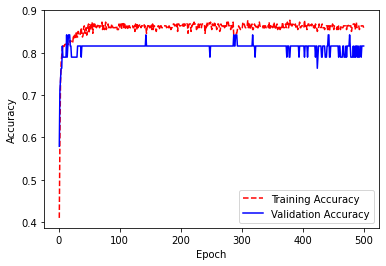

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 2.8835 - accuracy: 0.4494 - val_loss: 0.8094 - val_accuracy: 0.4474
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7921 - accuracy: 0.4949 - val_loss: 0.7377 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7182 - accuracy: 0.5733 - val_loss: 0.6617 - val_accuracy: 0.6579
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6252 - accuracy: 0.6

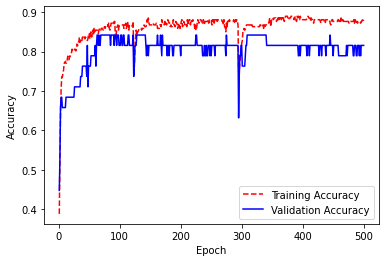

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 3.0827 - accuracy: 0.4959 - val_loss: 0.7476 - val_accuracy: 0.5789
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8321 - accuracy: 0.4913 - val_loss: 0.7329 - val_accuracy: 0.5789
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7703 - accuracy: 0.4905 - val_loss: 0.6384 - val_accuracy: 0.6579
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6412 - accuracy: 0.6

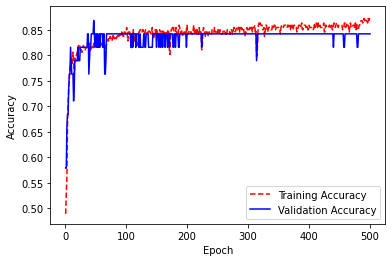

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 3.4974 - accuracy: 0.4487 - val_loss: 0.7561 - val_accuracy: 0.4474
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7361 - accuracy: 0.4804 - val_loss: 0.6953 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7101 - accuracy: 0.4960 - val_loss: 0.6766 - val_accuracy: 0.6316
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6928 - accuracy: 0.5

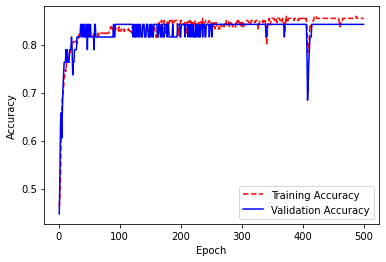

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 4.7268 - accuracy: 0.4692 - val_loss: 0.7131 - val_accuracy: 0.5789
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7534 - accuracy: 0.5146 - val_loss: 0.6747 - val_accuracy: 0.5789
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6930 - accuracy: 0.5750 - val_loss: 0.6398 - val_accuracy: 0.6842
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6494 - accuracy: 0.6

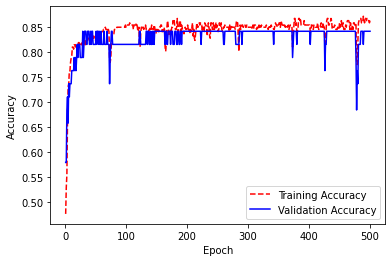

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 1.4873 - accuracy: 0.4535 - val_loss: 0.7559 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7739 - accuracy: 0.4605 - val_loss: 0.6998 - val_accuracy: 0.5526
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7381 - accuracy: 0.5073 - val_loss: 0.6813 - val_accuracy: 0.6316
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6940 - accuracy: 0.6

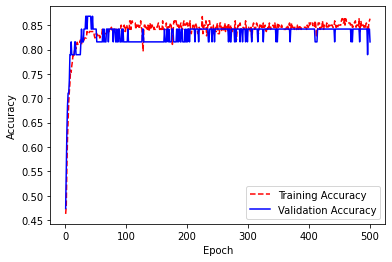

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3283 - accuracy: 0.8524 - val_loss: 0.4025 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3589 - accuracy: 0.8292 - val_loss: 0.4040 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3642 - accuracy: 0.8745 - val_loss: 0.4079 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3920 - accuracy: 0.8

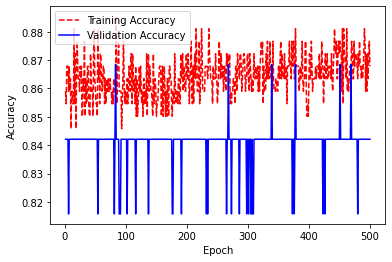

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3308 - accuracy: 0.8645 - val_loss: 0.3941 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3233 - accuracy: 0.8551 - val_loss: 0.3937 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 2s 113ms/step - loss: 0.3551 - accuracy: 0.8576 - val_loss: 0.3925 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3491 - accuracy: 0

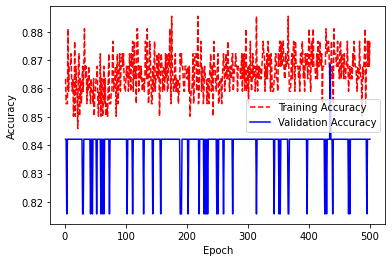

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3683 - accuracy: 0.8917 - val_loss: 0.4201 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4188 - accuracy: 0.8439 - val_loss: 0.4274 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4094 - accuracy: 0.8484 - val_loss: 0.4188 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3857 - accuracy: 0.8

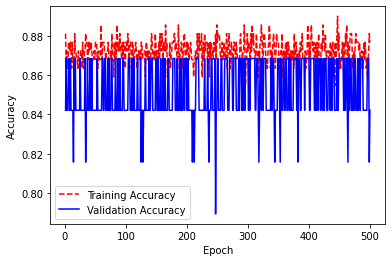

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3807 - accuracy: 0.8870 - val_loss: 0.4270 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3975 - accuracy: 0.8703 - val_loss: 0.4247 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3930 - accuracy: 0.8597 - val_loss: 0.4251 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.4089 - accuracy: 0.8

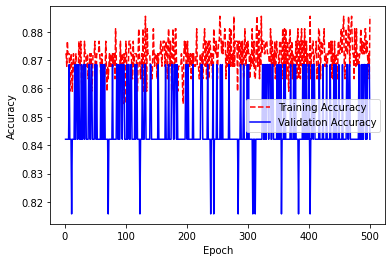

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3906 - accuracy: 0.8410 - val_loss: 0.4717 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5752 - accuracy: 0.7954 - val_loss: 0.7762 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7736 - accuracy: 0.8150 - val_loss: 8.1357 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 8.7533 - accuracy: 0.4

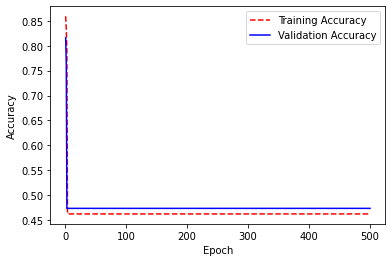

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 1.0166 - accuracy: 0.8026 - val_loss: 0.7971 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3726 - accuracy: 0.8367 - val_loss: 0.8051 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5791 - accuracy: 0.8483 - val_loss: 2.0480 - val_accuracy: 0.6316
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4309 - accuracy: 0.7

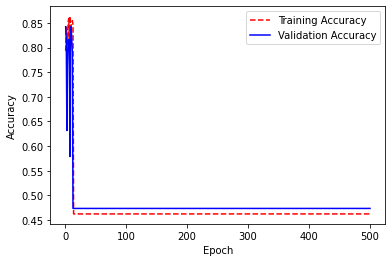

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.4435 - accuracy: 0.8578 - val_loss: 0.4485 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9331 - accuracy: 0.8447 - val_loss: 0.6729 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4704 - accuracy: 0.8505 - val_loss: 1.7447 - val_accuracy: 0.6579
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 3.8806 - accuracy: 0.6

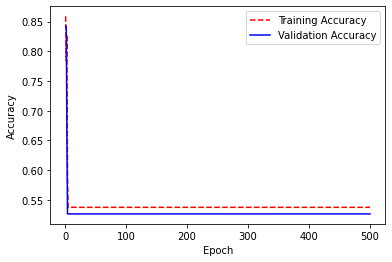

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.9587 - accuracy: 0.8147 - val_loss: 0.7840 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6340 - accuracy: 0.8330 - val_loss: 0.9504 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8887 - accuracy: 0.8297 - val_loss: 3.5812 - val_accuracy: 0.5789
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.7453 - accuracy: 0.7

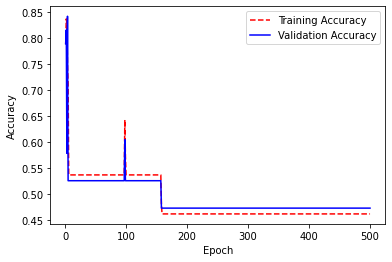

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3217 - accuracy: 0.8844 - val_loss: 0.7268 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3307 - accuracy: 0.8608 - val_loss: 0.7445 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4038 - accuracy: 0.8447 - val_loss: 0.7587 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9697 - accuracy: 0.7

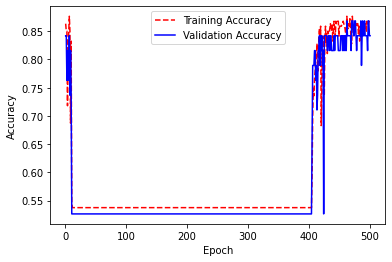

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3597 - accuracy: 0.8661 - val_loss: 0.7753 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3813 - accuracy: 0.8730 - val_loss: 0.8544 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3229 - accuracy: 0.8809 - val_loss: 0.5043 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.3788 - accuracy: 0.6

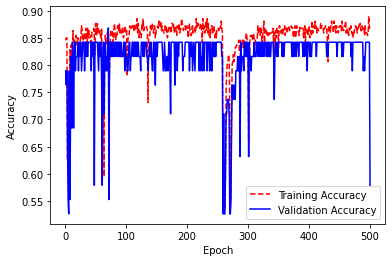

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 34ms/step - loss: 0.5961 - accuracy: 0.7479 - val_loss: 0.7756 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3699 - accuracy: 0.8625 - val_loss: 1.7230 - val_accuracy: 0.6316
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7314 - accuracy: 0.7310 - val_loss: 0.7233 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3935 - accuracy: 0.8

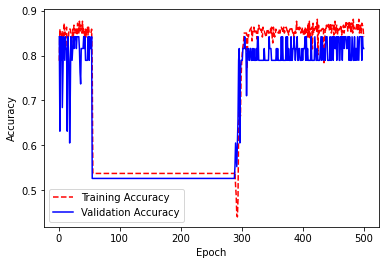

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.3551 - accuracy: 0.8557 - val_loss: 0.7924 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3734 - accuracy: 0.8613 - val_loss: 0.7966 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4673 - accuracy: 0.8330 - val_loss: 0.7959 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4915 - accuracy: 0.8

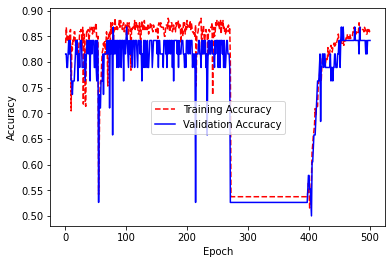

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.4028 - accuracy: 0.8540 - val_loss: 0.3997 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.3338 - accuracy: 0.8815 - val_loss: 0.3999 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3171 - accuracy: 0.8949 - val_loss: 0.3983 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3355 - accuracy: 0.8

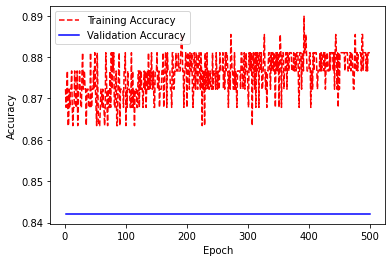

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.3401 - accuracy: 0.8990 - val_loss: 0.3931 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 8ms/step - loss: 0.3327 - accuracy: 0.8823 - val_loss: 0.3931 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3612 - accuracy: 0.8715 - val_loss: 0.3954 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3444 - accuracy: 0.8

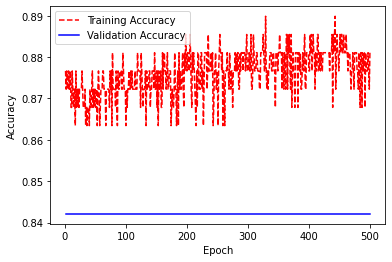

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.3698 - accuracy: 0.8681 - val_loss: 0.4079 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4251 - accuracy: 0.8520 - val_loss: 0.4128 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4277 - accuracy: 0.8475 - val_loss: 0.4169 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3157 - accuracy: 0.8

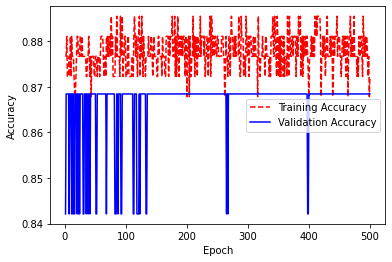

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.4031 - accuracy: 0.8562 - val_loss: 0.4007 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.3776 - accuracy: 0.8434 - val_loss: 0.4034 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3480 - accuracy: 0.8931 - val_loss: 0.4065 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4062 - accuracy: 0.8

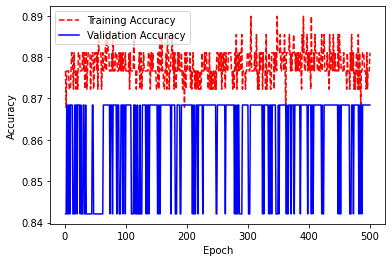

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 8.1180 - accuracy: 0.4738 - val_loss: 8.1189 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 9.0606 - accuracy: 0.4126 - val_loss: 8.1187 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 8.1823 - accuracy: 0.4648 - val_loss: 7.4787 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 6.7403 - accuracy: 0.4

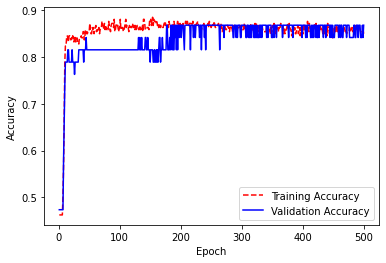

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 8.5772 - accuracy: 0.4457 - val_loss: 8.1441 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 8.4543 - accuracy: 0.4535 - val_loss: 8.1422 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 8.9684 - accuracy: 0.4201 - val_loss: 8.1405 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 8.9697 - accuracy: 0.4

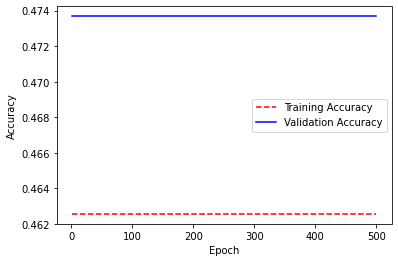

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 11.9614 - accuracy: 0.5517 - val_loss: 12.3445 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 11.4622 - accuracy: 0.5841 - val_loss: 12.3406 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 12.5989 - accuracy: 0.5093 - val_loss: 12.3368 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 12.2192 - accura

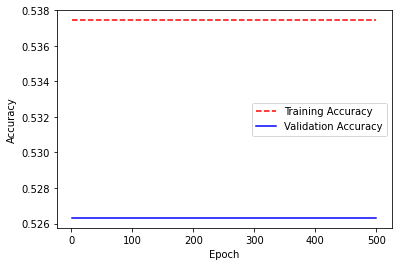

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 50ms/step - loss: 8.6689 - accuracy: 0.4479 - val_loss: 8.2696 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 8.4392 - accuracy: 0.4627 - val_loss: 8.2676 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 8.4797 - accuracy: 0.4599 - val_loss: 8.2658 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 8.0156 - accuracy: 0.4

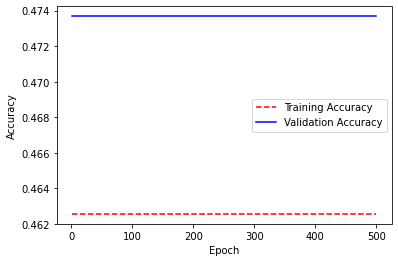

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.6124 - accuracy: 0.8646 - val_loss: 0.7255 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4357 - accuracy: 0.8565 - val_loss: 0.7183 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4925 - accuracy: 0.8281 - val_loss: 0.7155 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6716 - accuracy: 0.8

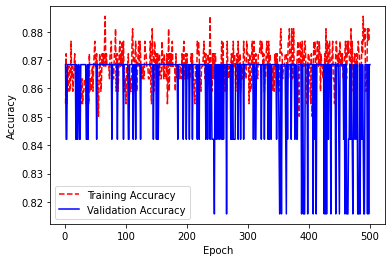

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.8844 - accuracy: 0.6149 - val_loss: 0.6543 - val_accuracy: 0.6579
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.5535 - accuracy: 0.7663 - val_loss: 0.5218 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4317 - accuracy: 0.8013 - val_loss: 0.4740 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3905 - accuracy: 0.8

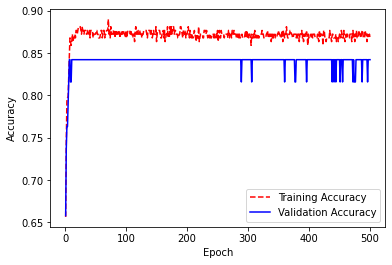

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 27ms/step - loss: 0.3456 - accuracy: 0.8722 - val_loss: 1.1190 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4693 - accuracy: 0.8484 - val_loss: 0.8409 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5940 - accuracy: 0.8724 - val_loss: 0.7964 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5009 - accuracy: 0.8

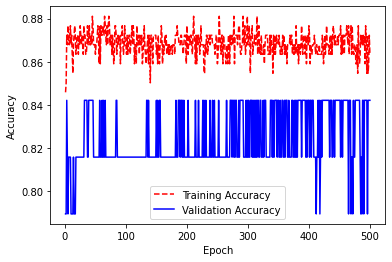

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5471 - accuracy: 0.8813 - val_loss: 0.4728 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6005 - accuracy: 0.8333 - val_loss: 0.4823 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4749 - accuracy: 0.8550 - val_loss: 0.4560 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4084 - accuracy: 0.8

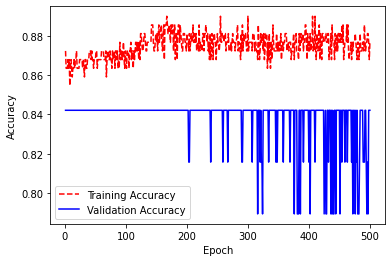

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6725 - accuracy: 0.8706 - val_loss: 0.7264 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7000 - accuracy: 0.8813 - val_loss: 0.7239 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6767 - accuracy: 0.8941 - val_loss: 0.7223 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6886 - accuracy: 0.8

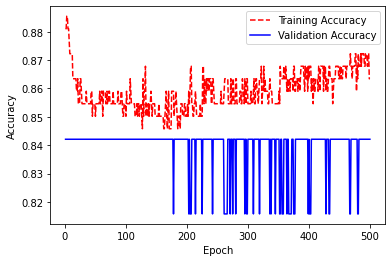

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.6937 - accuracy: 0.8628 - val_loss: 0.7321 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6822 - accuracy: 0.8470 - val_loss: 0.7249 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6676 - accuracy: 0.8822 - val_loss: 0.7223 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6799 - accuracy: 0.8

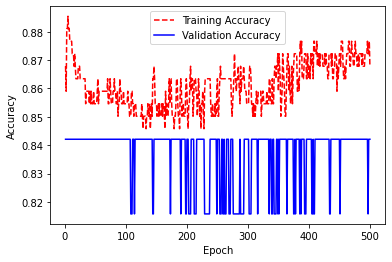

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.7320 - accuracy: 0.8789 - val_loss: 0.7470 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6923 - accuracy: 0.8584 - val_loss: 0.7433 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6906 - accuracy: 0.8763 - val_loss: 0.7411 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 9ms/step - loss: 0.7316 - accuracy: 0.8

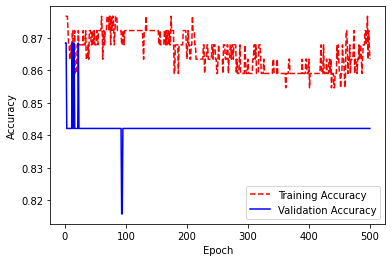

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.7152 - accuracy: 0.8614 - val_loss: 0.7492 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6774 - accuracy: 0.8936 - val_loss: 0.7467 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7014 - accuracy: 0.8908 - val_loss: 0.7428 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6953 - accuracy: 0.8

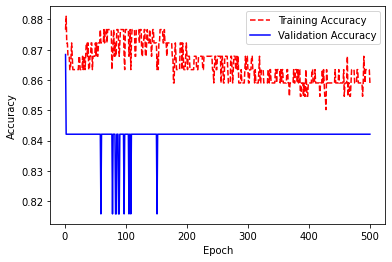

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6321 - accuracy: 0.8304 - val_loss: 0.7202 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6373 - accuracy: 0.8867 - val_loss: 0.7172 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6629 - accuracy: 0.8498 - val_loss: 0.7130 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6734 - accuracy: 0.8

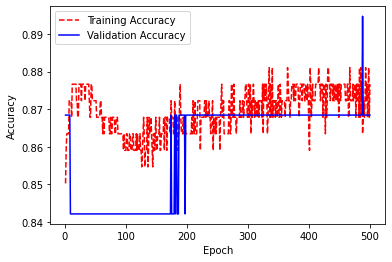

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 1.0000 - accuracy: 0.4442 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4554 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4553 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

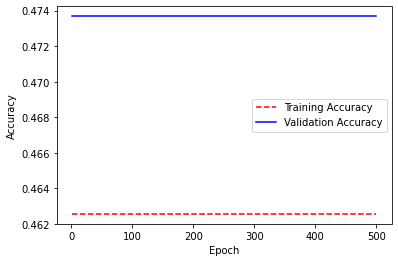

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 910.3558 - accuracy: 0.5110 - val_loss: 805.8320 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 766.6809 - accuracy: 0.5641 - val_loss: 795.2863 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 868.0817 - accuracy: 0.5289 - val_loss: 786.3499 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 857.4589 -

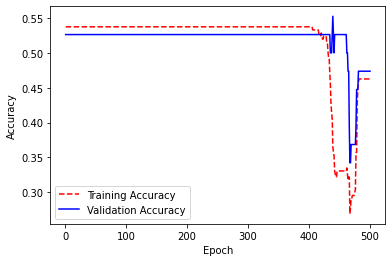

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 1.0001 - accuracy: 0.4589 - val_loss: 1.0001 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0001 - accuracy: 0.4893 - val_loss: 1.0001 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0001 - accuracy: 0.4664 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

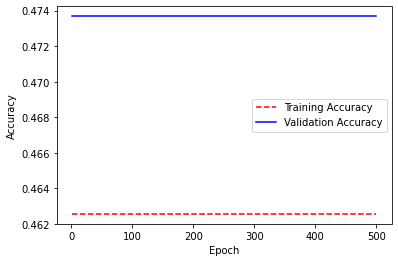

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5478 - accuracy: 0.8403 - val_loss: 0.5308 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4344 - accuracy: 0.8806 - val_loss: 0.5248 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4572 - accuracy: 0.8328 - val_loss: 0.5220 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.4378 - accuracy: 0.8

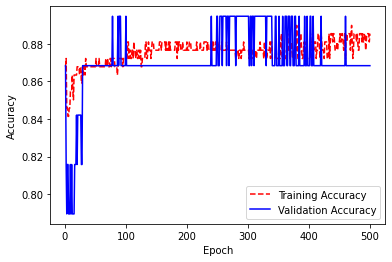

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.5344 - accuracy: 0.8537 - val_loss: 0.5835 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5026 - accuracy: 0.8682 - val_loss: 0.5751 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.4790 - accuracy: 0.8797 - val_loss: 0.5692 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4597 - accuracy: 0.8

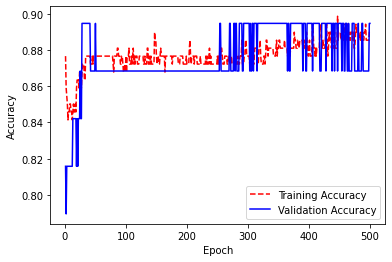

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.5141 - accuracy: 0.8796 - val_loss: 0.5879 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4876 - accuracy: 0.8623 - val_loss: 0.5815 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.8918 - val_loss: 0.5777 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4902 - accuracy: 0.8

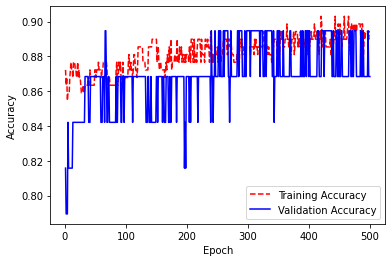

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 27ms/step - loss: 0.4794 - accuracy: 0.8912 - val_loss: 0.5926 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5577 - accuracy: 0.8518 - val_loss: 0.5816 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.4835 - accuracy: 0.8502 - val_loss: 0.5754 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5290 - accuracy: 0.8

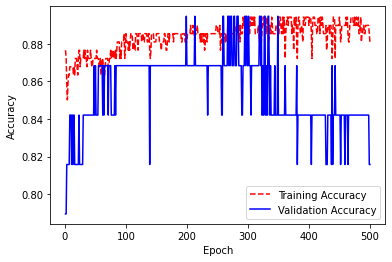

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6144 - accuracy: 0.8835 - val_loss: 0.6697 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6631 - accuracy: 0.8488 - val_loss: 0.6694 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5887 - accuracy: 0.8823 - val_loss: 0.6704 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6020 - accuracy: 0.8

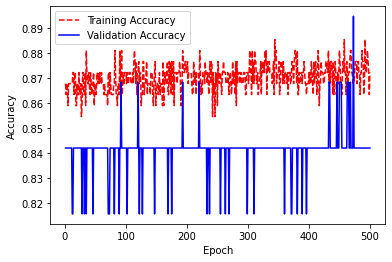

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6136 - accuracy: 0.8729 - val_loss: 0.6743 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5906 - accuracy: 0.8928 - val_loss: 0.6674 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6834 - accuracy: 0.8605 - val_loss: 0.6683 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6308 - accuracy: 0.8

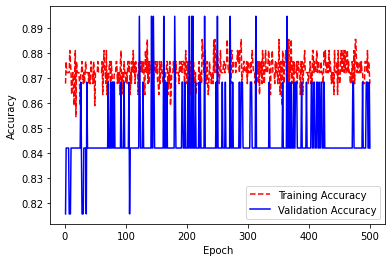

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.6739 - accuracy: 0.8729 - val_loss: 0.6931 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6541 - accuracy: 0.8771 - val_loss: 0.7001 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6688 - accuracy: 0.8874 - val_loss: 0.6923 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6921 - accuracy: 0.8

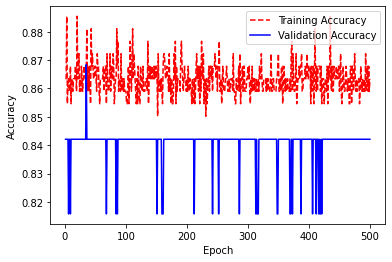

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6347 - accuracy: 0.8780 - val_loss: 0.6923 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6558 - accuracy: 0.8469 - val_loss: 0.6953 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6851 - accuracy: 0.8668 - val_loss: 0.6986 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5988 - accuracy: 0.8

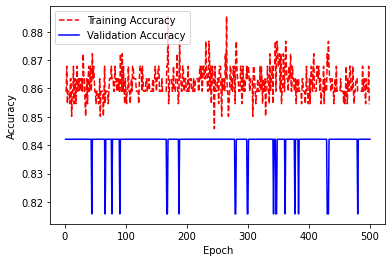

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6731 - accuracy: 0.8742 - val_loss: 0.6380 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6130 - accuracy: 0.8642 - val_loss: 0.6375 - val_accuracy: 0.8947
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5973 - accuracy: 0.8939 - val_loss: 0.6450 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6512 - accuracy: 0.8

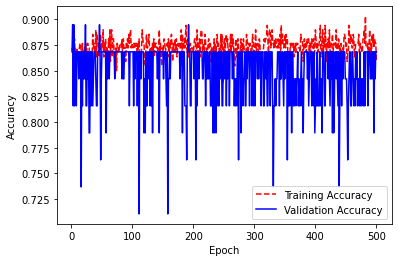

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 1.0000 - accuracy: 0.4364 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4661 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4716 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4

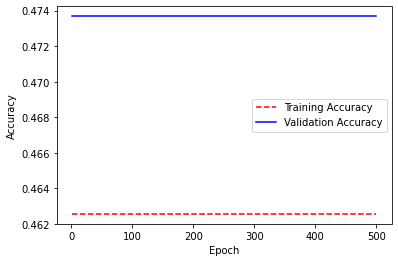

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 4.4016 - accuracy: 0.4287 - val_loss: 4.4013 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 1s 41ms/step - loss: 4.4012 - accuracy: 0.4805 - val_loss: 4.4009 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 4.4008 - accuracy: 0.4734 - val_loss: 4.4005 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 4.4004 - accuracy: 0.

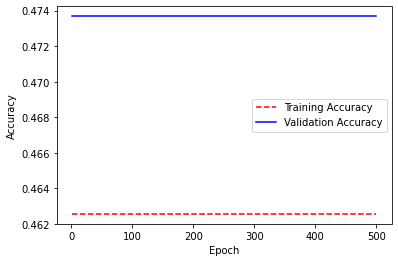

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 1.0000 - accuracy: 0.4696 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0000 - accuracy: 0.4685 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4389 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

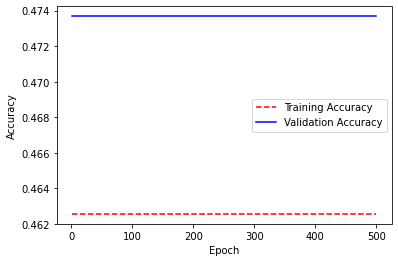

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.3634 - accuracy: 0.8307 - val_loss: 0.3688 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2527 - accuracy: 0.8899 - val_loss: 0.3330 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2714 - accuracy: 0.8724 - val_loss: 0.3594 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.3254 - accuracy: 0.8

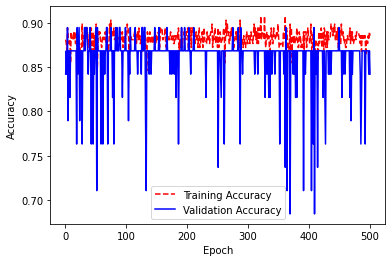

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.2562 - accuracy: 0.9160 - val_loss: 0.3398 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3202 - accuracy: 0.8675 - val_loss: 0.3304 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2649 - accuracy: 0.9094 - val_loss: 0.3319 - val_accuracy: 0.8947
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2931 - accuracy: 0.8

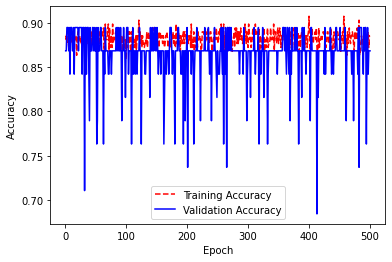

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 27ms/step - loss: 0.3323 - accuracy: 0.8771 - val_loss: 0.3942 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.3123 - accuracy: 0.8677 - val_loss: 0.3617 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2948 - accuracy: 0.9078 - val_loss: 0.4722 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3381 - accuracy: 0.8

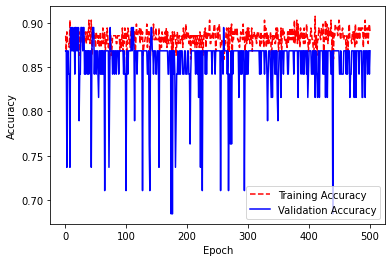

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.3046 - accuracy: 0.8816 - val_loss: 0.3957 - val_accuracy: 0.8158
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3047 - accuracy: 0.8894 - val_loss: 0.3994 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3268 - accuracy: 0.8787 - val_loss: 0.3883 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2769 - accuracy: 0.9

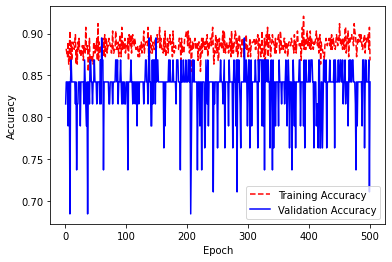

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.5938 - accuracy: 0.8351 - val_loss: 0.6636 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6470 - accuracy: 0.8611 - val_loss: 0.6626 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6195 - accuracy: 0.8830 - val_loss: 0.6628 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6469 - accuracy: 0.8

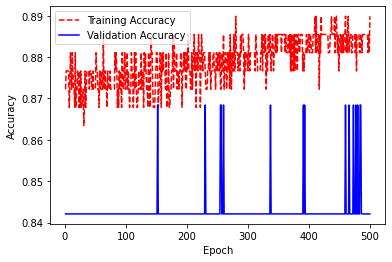

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.5672 - accuracy: 0.8521 - val_loss: 0.6637 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6142 - accuracy: 0.8868 - val_loss: 0.6634 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5463 - accuracy: 0.9000 - val_loss: 0.6631 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 8ms/step - loss: 0.5849 - accuracy: 0.8

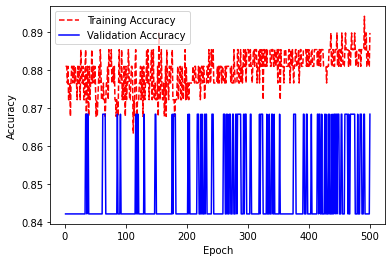

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.6411 - accuracy: 0.8681 - val_loss: 0.6903 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5796 - accuracy: 0.8886 - val_loss: 0.6929 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6061 - accuracy: 0.8746 - val_loss: 0.6938 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6704 - accuracy: 0.8

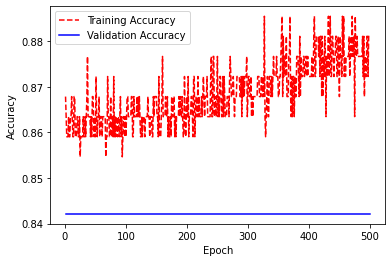

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.5924 - accuracy: 0.8813 - val_loss: 0.6898 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6581 - accuracy: 0.8588 - val_loss: 0.6903 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6516 - accuracy: 0.8334 - val_loss: 0.6907 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6789 - accuracy: 0.8

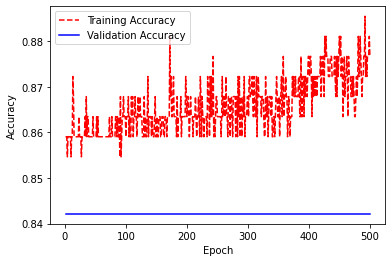

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.6822 - accuracy: 0.8632 - val_loss: 0.6428 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6194 - accuracy: 0.8855 - val_loss: 0.6414 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6218 - accuracy: 0.9020 - val_loss: 0.6416 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6716 - accuracy: 0.8

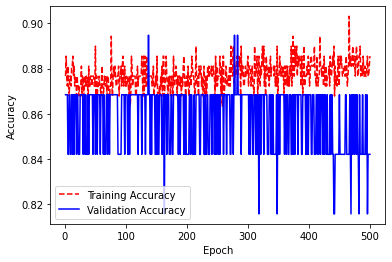

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 1.0000 - accuracy: 0.4936 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4531 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4677 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

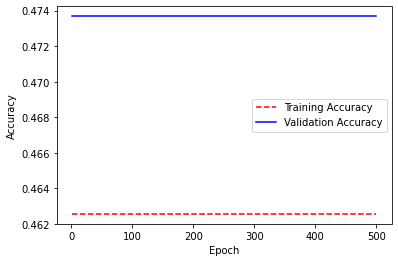

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 4.1986 - accuracy: 0.5045 - val_loss: 4.1955 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 4.1946 - accuracy: 0.4607 - val_loss: 4.1915 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 4.1905 - accuracy: 0.4503 - val_loss: 4.1875 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 4.1865 - accuracy: 0.4

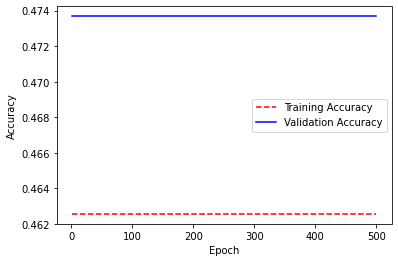

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 1.0001 - accuracy: 0.4576 - val_loss: 1.0003 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0002 - accuracy: 0.4799 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0001 - accuracy: 0.4342 - val_loss: 1.0003 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0002 - accuracy: 0.4

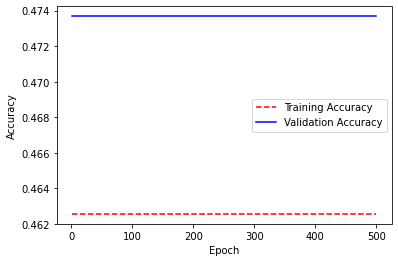

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 2s 61ms/step - loss: 0.3253 - accuracy: 0.8997 - val_loss: 0.3368 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2595 - accuracy: 0.9129 - val_loss: 0.3294 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2207 - accuracy: 0.9263 - val_loss: 0.3282 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2637 - accuracy: 0.8

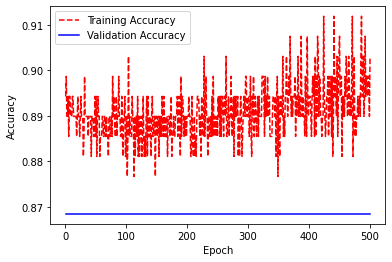

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.2721 - accuracy: 0.8877 - val_loss: 0.3308 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2697 - accuracy: 0.8935 - val_loss: 0.3302 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3020 - accuracy: 0.8853 - val_loss: 0.3300 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2843 - accuracy: 0.8

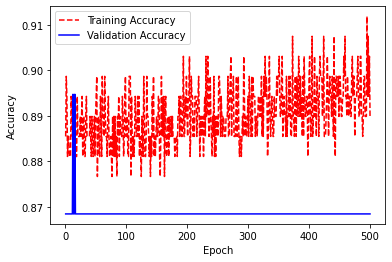

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.3812 - accuracy: 0.8802 - val_loss: 0.3610 - val_accuracy: 0.8684
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3041 - accuracy: 0.9028 - val_loss: 0.3589 - val_accuracy: 0.8684
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.2756 - accuracy: 0.9214 - val_loss: 0.3596 - val_accuracy: 0.8684
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3452 - accuracy: 0.8

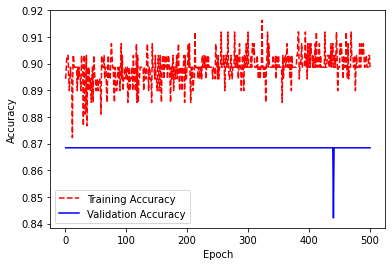

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.3227 - accuracy: 0.8982 - val_loss: 0.3916 - val_accuracy: 0.8421
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3018 - accuracy: 0.9011 - val_loss: 0.3985 - val_accuracy: 0.8421
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2796 - accuracy: 0.8962 - val_loss: 0.3973 - val_accuracy: 0.8421
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2846 - accuracy: 0.9

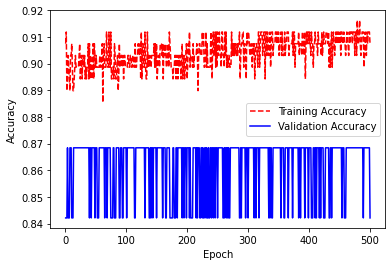

In [21]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [22]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.31
Test fraction correct (NN-Accuracy) = 0.84


**Softmax**

In [13]:
#try different activation functions and regularizers
Possible_activations = ['softmax']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.7155 - accuracy: 0.5319 - val_loss: 0.7193 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6898 - accuracy: 0.4631 - val_loss: 0.7056 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6810 - accuracy: 0.4948 - val_loss: 0.6935 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6677 - accuracy: 0.56

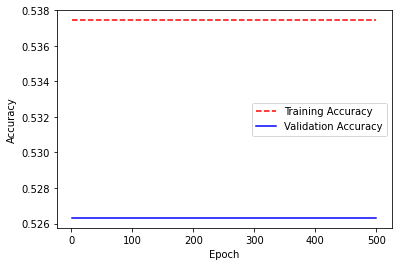

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6906 - accuracy: 0.5309 - val_loss: 0.6526 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6286 - accuracy: 0.5321 - val_loss: 0.6072 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.5803 - accuracy: 0.5564 - val_loss: 0.5722 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5475 - accuracy: 0.51

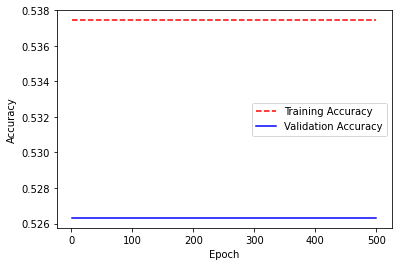

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6961 - accuracy: 0.5582 - val_loss: 0.6467 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6354 - accuracy: 0.5381 - val_loss: 0.6104 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5782 - accuracy: 0.5779 - val_loss: 0.5805 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5493 - accuracy: 0.53

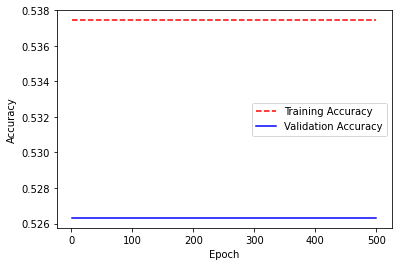

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6982 - accuracy: 0.5465 - val_loss: 0.6939 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6921 - accuracy: 0.5084 - val_loss: 0.6900 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6838 - accuracy: 0.5582 - val_loss: 0.6833 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6711 - accuracy: 0.53

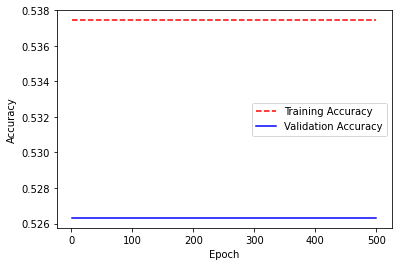

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3443 - accuracy: 0.6023 - val_loss: 0.3938 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3970 - accuracy: 0.5190 - val_loss: 0.3951 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3838 - accuracy: 0.5615 - val_loss: 0.4008 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3509 - accuracy: 0.51

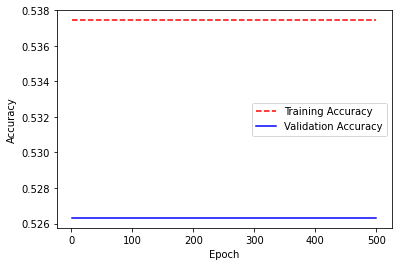

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3314 - accuracy: 0.5221 - val_loss: 0.3993 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3266 - accuracy: 0.5436 - val_loss: 0.3988 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3087 - accuracy: 0.5417 - val_loss: 0.4006 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3083 - accuracy: 0.54

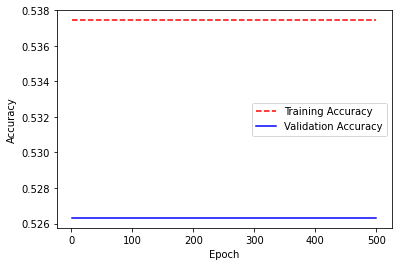

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3809 - accuracy: 0.5312 - val_loss: 0.4157 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3492 - accuracy: 0.5259 - val_loss: 0.4290 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3652 - accuracy: 0.5482 - val_loss: 0.4223 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.3811 - accuracy: 0.54

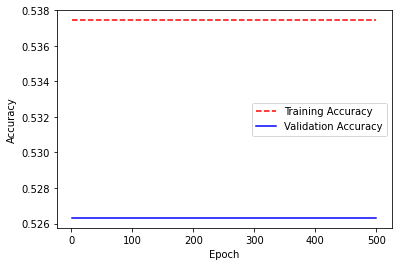

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3756 - accuracy: 0.4922 - val_loss: 0.4242 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3716 - accuracy: 0.5283 - val_loss: 0.4283 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3485 - accuracy: 0.5397 - val_loss: 0.4318 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3900 - accuracy: 0.59

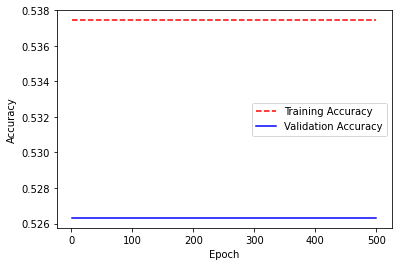

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 65ms/step - loss: 0.3524 - accuracy: 0.5627 - val_loss: 0.3989 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3745 - accuracy: 0.5450 - val_loss: 0.4013 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3383 - accuracy: 0.5058 - val_loss: 0.3935 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.2554 - accuracy: 0.48

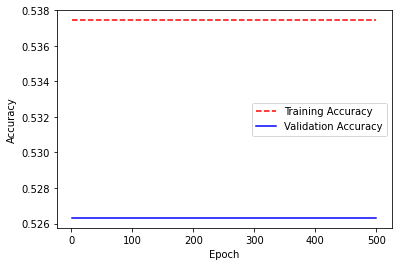

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.3548 - accuracy: 0.5071 - val_loss: 0.3919 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3234 - accuracy: 0.5383 - val_loss: 0.3934 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3226 - accuracy: 0.5592 - val_loss: 0.3944 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3235 - accuracy: 0.51

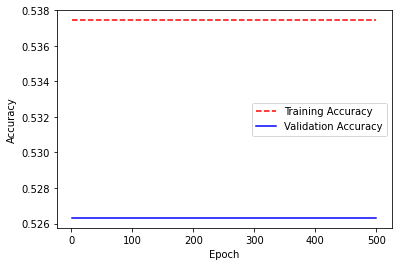

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3695 - accuracy: 0.5744 - val_loss: 0.4127 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.3554 - accuracy: 0.5059 - val_loss: 0.4074 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3169 - accuracy: 0.4851 - val_loss: 0.4099 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3349 - accuracy: 0.49

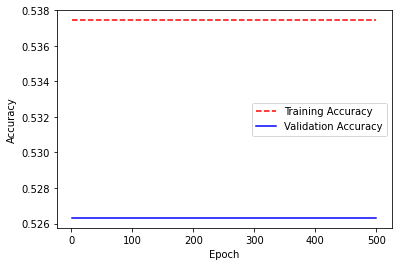

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.3534 - accuracy: 0.5822 - val_loss: 0.4138 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3186 - accuracy: 0.5765 - val_loss: 0.4182 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3272 - accuracy: 0.5589 - val_loss: 0.4173 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.3809 - accuracy: 0.53

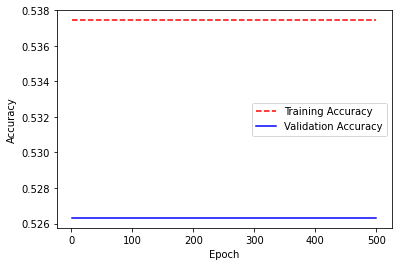

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9652 - accuracy: 0.5265 - val_loss: 0.9654 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9478 - accuracy: 0.5351 - val_loss: 0.9653 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9499 - accuracy: 0.5340 - val_loss: 0.9652 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9455 - accuracy: 0.53

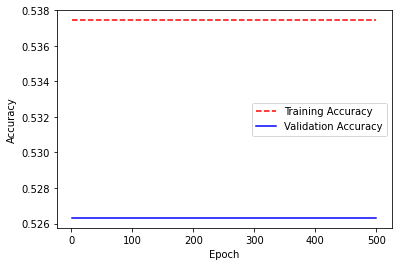

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.9812 - accuracy: 0.5185 - val_loss: 0.9655 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9465 - accuracy: 0.5358 - val_loss: 0.9654 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8188 - accuracy: 0.5996 - val_loss: 0.9653 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9039 - accuracy: 0.55

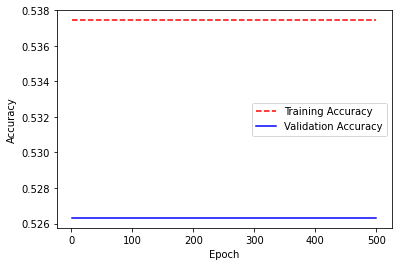

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9137 - accuracy: 0.5632 - val_loss: 0.9873 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9691 - accuracy: 0.5353 - val_loss: 0.9870 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9748 - accuracy: 0.5324 - val_loss: 0.9868 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9867 - accuracy: 0.52

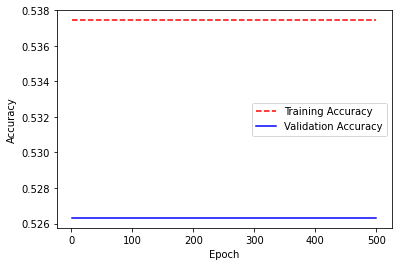

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 32ms/step - loss: 0.9580 - accuracy: 0.5417 - val_loss: 0.9886 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0813 - accuracy: 0.4799 - val_loss: 0.9883 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0609 - accuracy: 0.4900 - val_loss: 0.9880 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9357 - accuracy: 0.55

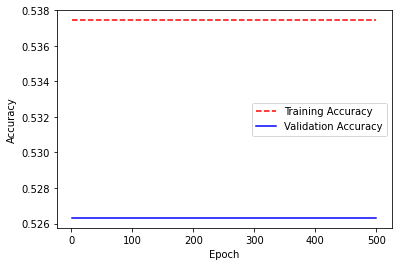

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.8795 - accuracy: 0.5602 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9836 - accuracy: 0.5082 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9998 - accuracy: 0.5001 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9835 - accuracy: 0.50

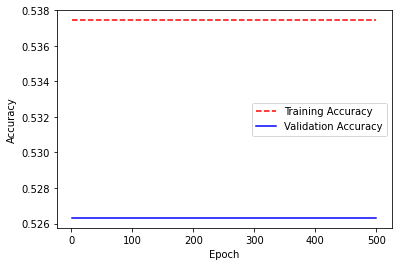

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.9592 - accuracy: 0.5204 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8910 - accuracy: 0.5545 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8667 - accuracy: 0.5667 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9950 - accuracy: 0.50

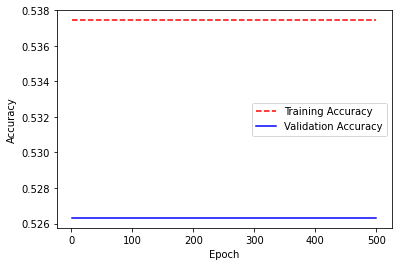

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9128 - accuracy: 0.5436 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8921 - accuracy: 0.5539 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0071 - accuracy: 0.4964 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9346 - accuracy: 0.53

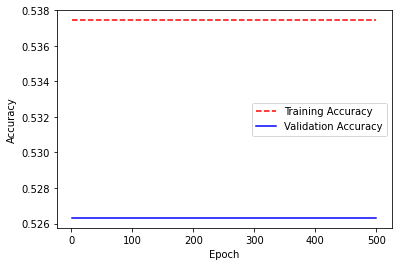

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.9455 - accuracy: 0.5272 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0259 - accuracy: 0.4870 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9199 - accuracy: 0.5401 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9091 - accuracy: 0.54

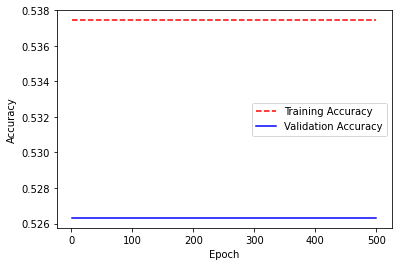

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 1.0059 - accuracy: 0.4970 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9690 - accuracy: 0.5155 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9207 - accuracy: 0.5397 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9551 - accuracy: 0.52

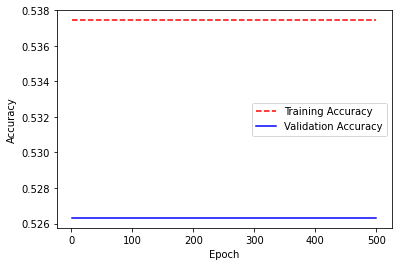

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9643 - accuracy: 0.5179 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9077 - accuracy: 0.5462 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9190 - accuracy: 0.5405 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0150 - accuracy: 0.49

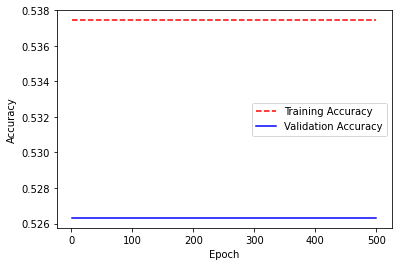

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.9708 - accuracy: 0.5146 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8636 - accuracy: 0.5682 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9092 - accuracy: 0.5454 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8515 - accuracy: 0.57

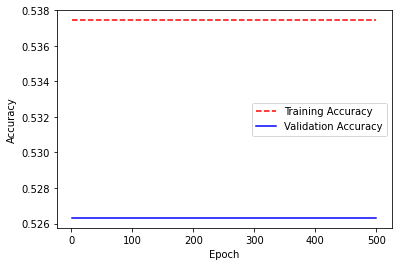

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.8733 - accuracy: 0.5634 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9703 - accuracy: 0.5149 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9643 - accuracy: 0.5179 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9347 - accuracy: 0.53

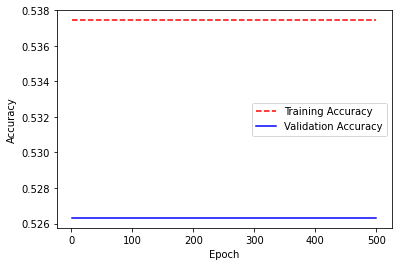

In [14]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [15]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.79
Test fraction correct (NN-Accuracy) = 0.61


# For scaling NormlizerdScaler

In [ ]:
#try different activation functions and regularizers
Possible_activations = ['sigmoid','relu','tanh']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6934 - accuracy: 0.5248 - val_loss: 0.6929 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6927 - accuracy: 0.5363 - val_loss: 0.6925 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6929 - accuracy: 0.4966 - val_loss: 0.6922 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6925 - accuracy: 0.5

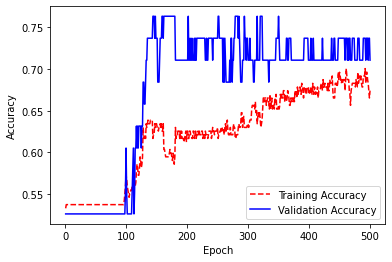

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6926 - accuracy: 0.5118 - val_loss: 0.6884 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6857 - accuracy: 0.5451 - val_loss: 0.6864 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6806 - accuracy: 0.5695 - val_loss: 0.6843 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6873 - accuracy: 0.5

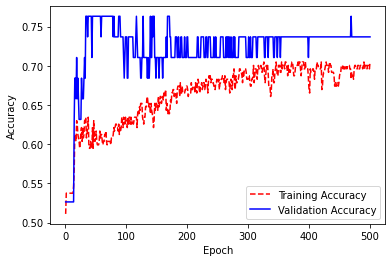

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6989 - accuracy: 0.5476 - val_loss: 0.6925 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6884 - accuracy: 0.5754 - val_loss: 0.6912 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6915 - accuracy: 0.5285 - val_loss: 0.6900 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6937 - accuracy: 0.4

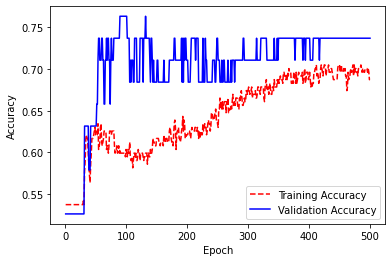

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6957 - accuracy: 0.5574 - val_loss: 0.6914 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6899 - accuracy: 0.5447 - val_loss: 0.6896 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6885 - accuracy: 0.5505 - val_loss: 0.6882 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6866 - accuracy: 0.5

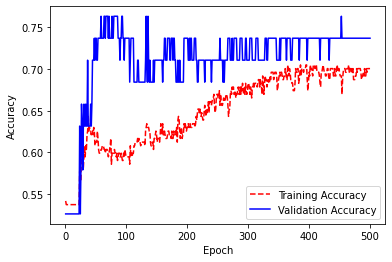

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 3.5721 - accuracy: 0.4444 - val_loss: 1.1570 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.1837 - accuracy: 0.4555 - val_loss: 1.0524 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.9883 - accuracy: 0.4989 - val_loss: 1.0323 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9702 - accuracy: 0.5

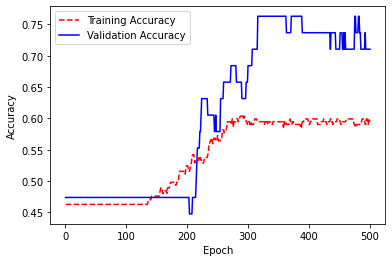

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 5.8168 - accuracy: 0.4279 - val_loss: 1.7094 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.5862 - accuracy: 0.4909 - val_loss: 1.5086 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.5916 - accuracy: 0.4346 - val_loss: 1.4251 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 1.4859 - accuracy: 0.4

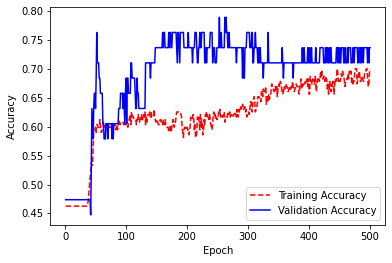

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 2.8786 - accuracy: 0.4800 - val_loss: 1.6309 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.5498 - accuracy: 0.4772 - val_loss: 1.4064 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.3578 - accuracy: 0.4806 - val_loss: 1.2869 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.2857 - accuracy: 0.4

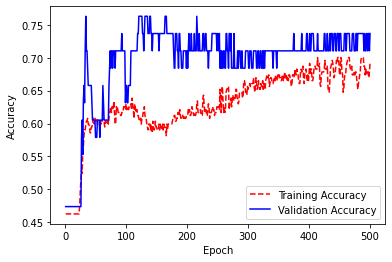

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 7.4133 - accuracy: 0.4619 - val_loss: 1.4776 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.3384 - accuracy: 0.4735 - val_loss: 1.0963 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.1377 - accuracy: 0.4326 - val_loss: 0.9830 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.9718 - accuracy: 0.4

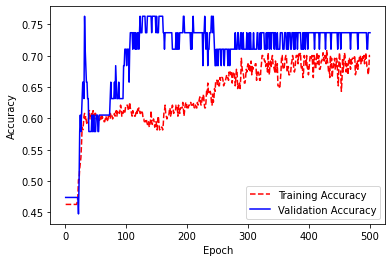

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 8.1399 - accuracy: 0.4723 - val_loss: 3.8753 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 1.8316 - accuracy: 0.5633 - val_loss: 1.1289 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 1.0879 - accuracy: 0.4590 - val_loss: 0.9375 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0323 - accuracy: 0.3

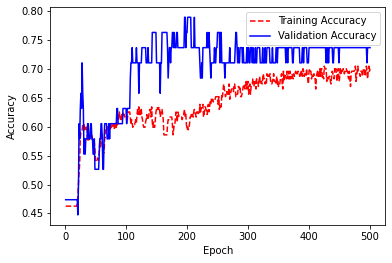

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 1.4707 - accuracy: 0.4323 - val_loss: 0.7672 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7458 - accuracy: 0.4705 - val_loss: 0.6869 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6975 - accuracy: 0.4845 - val_loss: 0.6749 - val_accuracy: 0.6579
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6793 - accuracy: 0.6

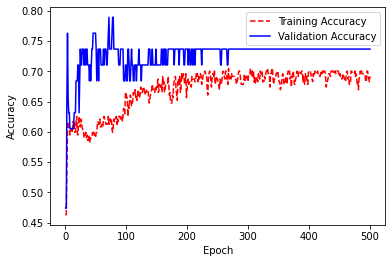

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 1.3319 - accuracy: 0.4237 - val_loss: 0.8267 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.8253 - accuracy: 0.4394 - val_loss: 0.7241 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7268 - accuracy: 0.4485 - val_loss: 0.7023 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.7066 - accuracy: 0.4

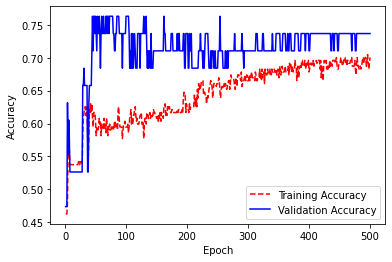

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 2s 120ms/step - loss: 3.1248 - accuracy: 0.4600 - val_loss: 1.0464 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9713 - accuracy: 0.4915 - val_loss: 0.9104 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8952 - accuracy: 0.4762 - val_loss: 0.8602 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8936 - accuracy: 0.

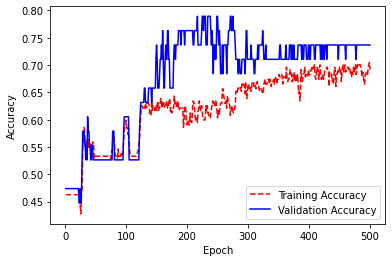

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6298 - accuracy: 0.6710 - val_loss: 0.5716 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6242 - accuracy: 0.6707 - val_loss: 0.5715 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6190 - accuracy: 0.6640 - val_loss: 0.5706 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6113 - accuracy: 0.7

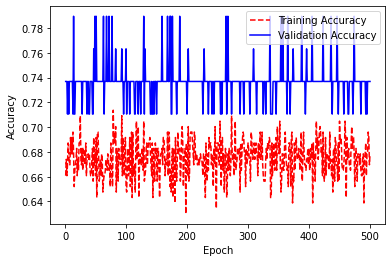

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6422 - accuracy: 0.6504 - val_loss: 0.5541 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5852 - accuracy: 0.7428 - val_loss: 0.5659 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6307 - accuracy: 0.6517 - val_loss: 0.5523 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6130 - accuracy: 0.6

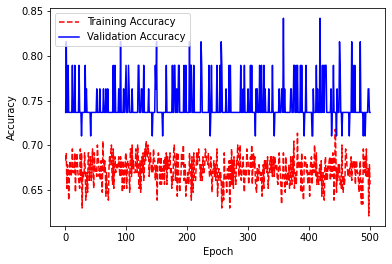

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6409 - accuracy: 0.6496 - val_loss: 0.5575 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 4ms/step - loss: 0.6049 - accuracy: 0.7379 - val_loss: 0.5613 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6388 - accuracy: 0.6527 - val_loss: 0.5581 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6315 - accuracy: 0.6

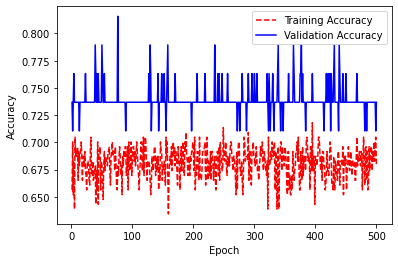

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 14ms/step - loss: 0.6331 - accuracy: 0.6662 - val_loss: 0.5515 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6357 - accuracy: 0.6794 - val_loss: 0.5553 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6398 - accuracy: 0.6181 - val_loss: 0.5513 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6353 - accuracy: 0.6

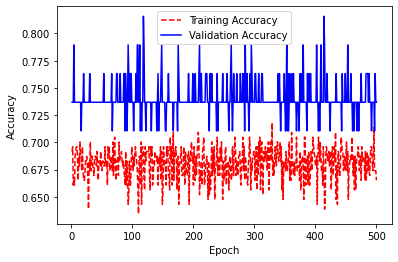

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6326 - accuracy: 0.6657 - val_loss: 0.7141 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7473 - accuracy: 0.5721 - val_loss: 0.6251 - val_accuracy: 0.6053
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6820 - accuracy: 0.5830 - val_loss: 0.6750 - val_accuracy: 0.5000
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6825 - accuracy: 0.5

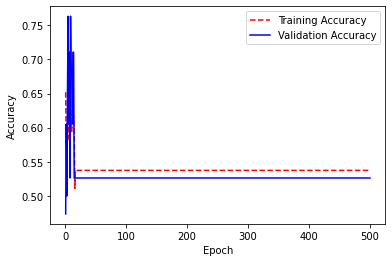

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6296 - accuracy: 0.6922 - val_loss: 0.5633 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6240 - accuracy: 0.6421 - val_loss: 0.5676 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6434 - accuracy: 0.6307 - val_loss: 0.5674 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6253 - accuracy: 0.6

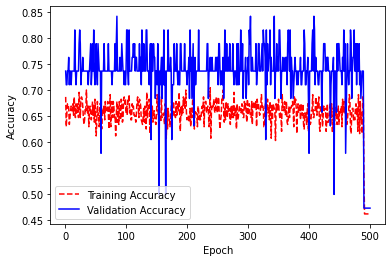

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6101 - accuracy: 0.7102 - val_loss: 0.5798 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6323 - accuracy: 0.6653 - val_loss: 0.5742 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6499 - accuracy: 0.6263 - val_loss: 0.5625 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6488 - accuracy: 0.6

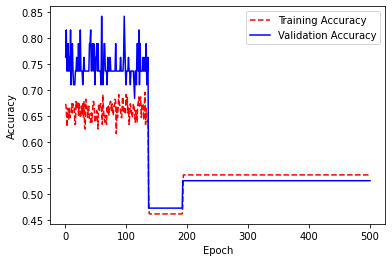

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6411 - accuracy: 0.6788 - val_loss: 0.6013 - val_accuracy: 0.6053
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6514 - accuracy: 0.6377 - val_loss: 0.5546 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6621 - accuracy: 0.6219 - val_loss: 0.5530 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6185 - accuracy: 0.6

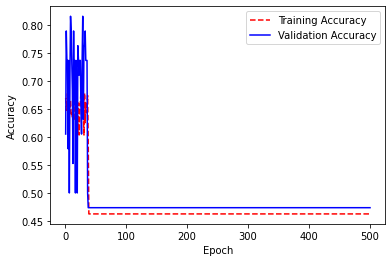

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 15ms/step - loss: 0.6128 - accuracy: 0.7220 - val_loss: 0.5410 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6223 - accuracy: 0.6661 - val_loss: 0.5355 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6419 - accuracy: 0.6452 - val_loss: 0.5331 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6108 - accuracy: 0.6

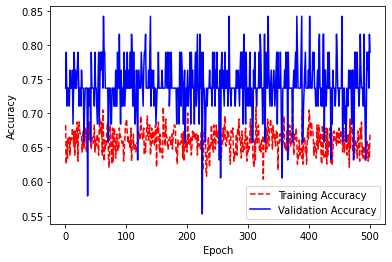

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6455 - accuracy: 0.6366 - val_loss: 0.5375 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5948 - accuracy: 0.7011 - val_loss: 0.5228 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6285 - accuracy: 0.6631 - val_loss: 0.5385 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.5940 - accuracy: 0.6

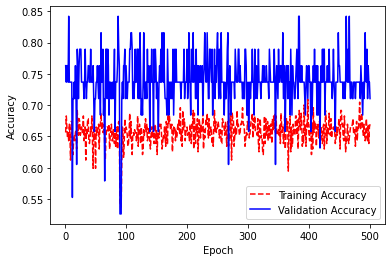

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 0.6505 - accuracy: 0.6694 - val_loss: 0.5348 - val_accuracy: 0.7105
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6354 - accuracy: 0.6423 - val_loss: 0.5348 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6088 - accuracy: 0.6865 - val_loss: 0.5397 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6324 - accuracy: 0.6

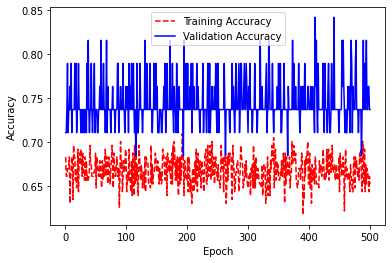

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6210 - accuracy: 0.6737 - val_loss: 0.5642 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6260 - accuracy: 0.6968 - val_loss: 0.5491 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6343 - accuracy: 0.6219 - val_loss: 0.5398 - val_accuracy: 0.8158
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6067 - accuracy: 0.6

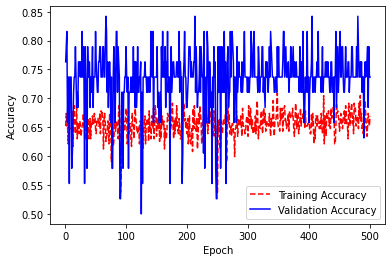

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6155 - accuracy: 0.6959 - val_loss: 0.5628 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 9ms/step - loss: 0.6228 - accuracy: 0.7155 - val_loss: 0.5628 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6087 - accuracy: 0.7085 - val_loss: 0.5626 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6229 - accuracy: 0.7

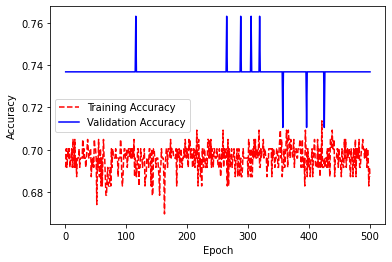

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6300 - accuracy: 0.7118 - val_loss: 0.5516 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6363 - accuracy: 0.6513 - val_loss: 0.5517 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6336 - accuracy: 0.6833 - val_loss: 0.5512 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6584 - accuracy: 0.6

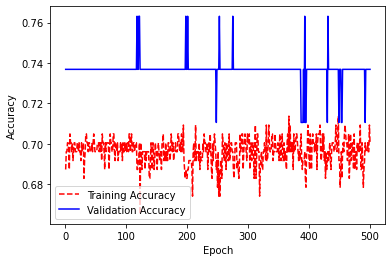

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.6392 - accuracy: 0.6831 - val_loss: 0.5500 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6141 - accuracy: 0.7232 - val_loss: 0.5498 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6267 - accuracy: 0.7009 - val_loss: 0.5498 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 8ms/step - loss: 0.6333 - accuracy: 0.6

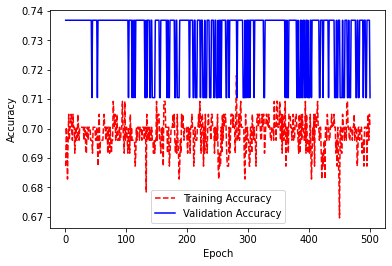

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.6478 - accuracy: 0.6815 - val_loss: 0.5477 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6446 - accuracy: 0.6821 - val_loss: 0.5474 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6095 - accuracy: 0.7227 - val_loss: 0.5476 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6247 - accuracy: 0.6

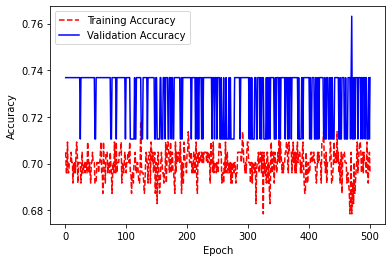

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 26ms/step - loss: 6.7442 - accuracy: 0.5581 - val_loss: 7.2281 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 6.8499 - accuracy: 0.5511 - val_loss: 7.2278 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 7.6064 - accuracy: 0.5015 - val_loss: 7.2275 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 7.5012 - accuracy: 0.5

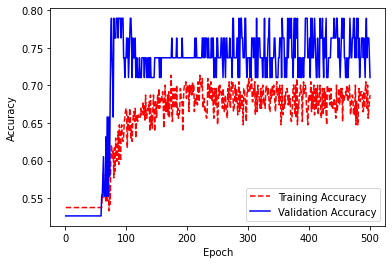

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 27ms/step - loss: 8.2801 - accuracy: 0.4641 - val_loss: 8.1311 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 8.6624 - accuracy: 0.4392 - val_loss: 8.1305 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 9.0446 - accuracy: 0.4144 - val_loss: 8.1299 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 8.5351 - accuracy: 0.4

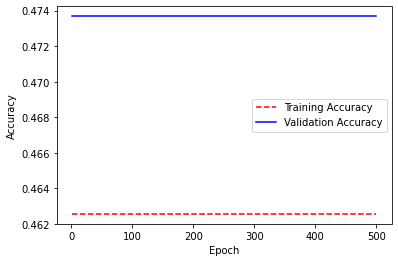

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 7.5523 - accuracy: 0.5079 - val_loss: 7.2715 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 6.8435 - accuracy: 0.5544 - val_loss: 7.2709 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 7.1950 - accuracy: 0.5313 - val_loss: 7.2705 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 6.8188 - accuracy: 0.5

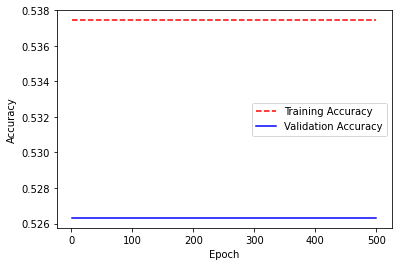

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 8.8287 - accuracy: 0.4280 - val_loss: 8.1231 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 8.9538 - accuracy: 0.4198 - val_loss: 8.1226 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 7.9373 - accuracy: 0.4857 - val_loss: 8.1224 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 7.7739 - accuracy: 0.4

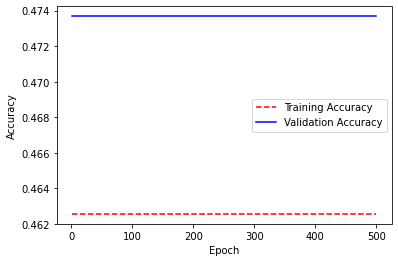

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6358 - accuracy: 0.6178 - val_loss: 0.5429 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6307 - accuracy: 0.6332 - val_loss: 0.5399 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6394 - accuracy: 0.6664 - val_loss: 0.5367 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6081 - accuracy: 0.7

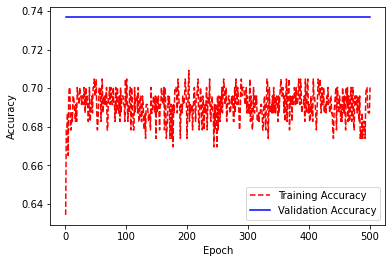

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.6440 - accuracy: 0.6173 - val_loss: 0.5549 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6414 - accuracy: 0.6398 - val_loss: 0.5451 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6187 - accuracy: 0.6545 - val_loss: 0.5381 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6118 - accuracy: 0.7

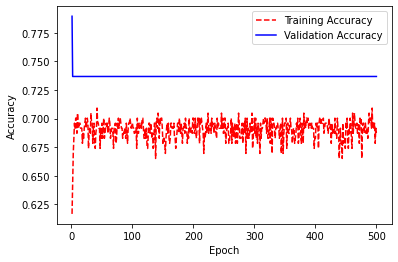

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.6177 - accuracy: 0.7057 - val_loss: 0.5400 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6156 - accuracy: 0.6808 - val_loss: 0.5376 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6609 - accuracy: 0.6782 - val_loss: 0.5369 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6366 - accuracy: 0.6

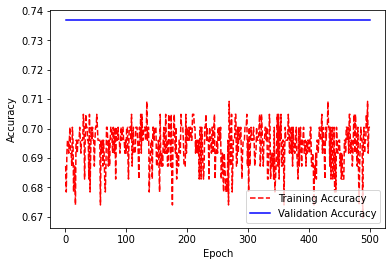

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.6502 - accuracy: 0.6655 - val_loss: 0.5327 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6162 - accuracy: 0.7024 - val_loss: 0.5333 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6164 - accuracy: 0.7172 - val_loss: 0.5326 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6100 - accuracy: 0.7

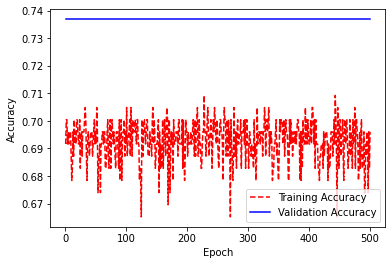

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.8402 - accuracy: 0.7271 - val_loss: 0.8824 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9193 - accuracy: 0.6366 - val_loss: 0.8814 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9548 - accuracy: 0.7132 - val_loss: 0.8808 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8941 - accuracy: 0.7

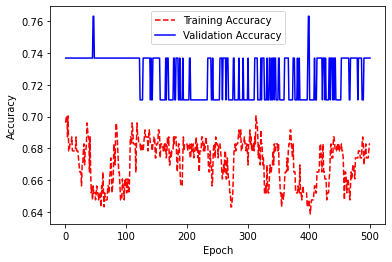

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.8983 - accuracy: 0.7237 - val_loss: 0.8791 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.9097 - accuracy: 0.7133 - val_loss: 0.8784 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9148 - accuracy: 0.6815 - val_loss: 0.8779 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9045 - accuracy: 0.6

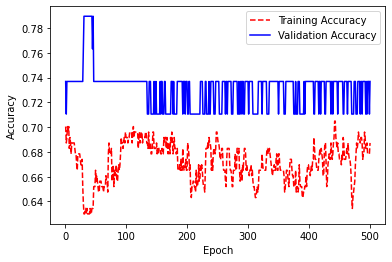

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 48ms/step - loss: 0.9090 - accuracy: 0.6713 - val_loss: 0.8822 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9330 - accuracy: 0.6865 - val_loss: 0.8817 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9532 - accuracy: 0.7092 - val_loss: 0.8810 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9311 - accuracy: 0.6

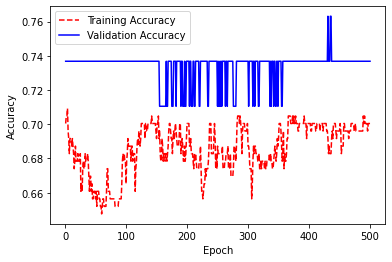

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.9026 - accuracy: 0.7067 - val_loss: 0.8814 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8908 - accuracy: 0.6794 - val_loss: 0.8808 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9339 - accuracy: 0.7176 - val_loss: 0.8805 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9597 - accuracy: 0.7

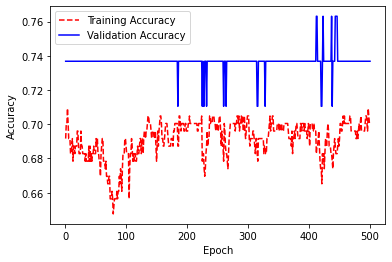

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.9101 - accuracy: 0.6737 - val_loss: 0.8822 - val_accuracy: 0.7105
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9296 - accuracy: 0.7135 - val_loss: 0.8819 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9146 - accuracy: 0.6743 - val_loss: 0.8816 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8241 - accuracy: 0.7

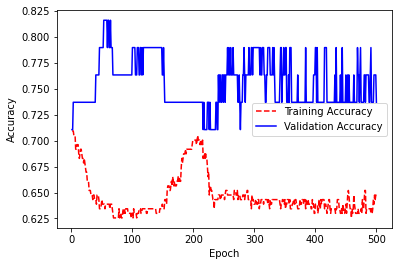

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 1.0000 - accuracy: 0.4704 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4959 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4522 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4

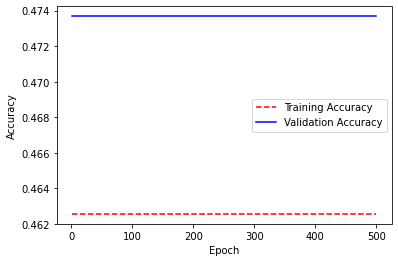

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 1.4136 - accuracy: 0.5301 - val_loss: 1.4142 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.2965 - accuracy: 0.5643 - val_loss: 1.3950 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.3205 - accuracy: 0.5498 - val_loss: 1.3731 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 1.3656 - accuracy: 0.5

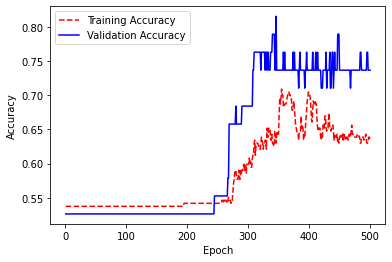

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 1.0001 - accuracy: 0.4097 - val_loss: 1.0001 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0001 - accuracy: 0.4928 - val_loss: 1.0001 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0001 - accuracy: 0.4557 - val_loss: 1.0001 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0001 - accuracy: 0.4

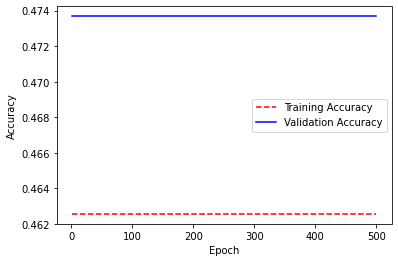

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.8875 - accuracy: 0.6742 - val_loss: 0.8644 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8874 - accuracy: 0.6681 - val_loss: 0.8629 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8519 - accuracy: 0.7212 - val_loss: 0.8616 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8624 - accuracy: 0.7

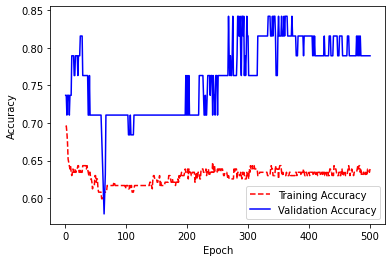

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8670 - accuracy: 0.7054 - val_loss: 0.8661 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8987 - accuracy: 0.7008 - val_loss: 0.8656 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9111 - accuracy: 0.7135 - val_loss: 0.8650 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.9069 - accuracy: 0.6

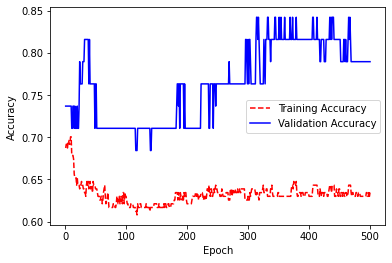

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.8424 - accuracy: 0.6780 - val_loss: 0.8711 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8756 - accuracy: 0.7286 - val_loss: 0.8695 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8852 - accuracy: 0.7088 - val_loss: 0.8680 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 10ms/step - loss: 0.9323 - accuracy: 0.

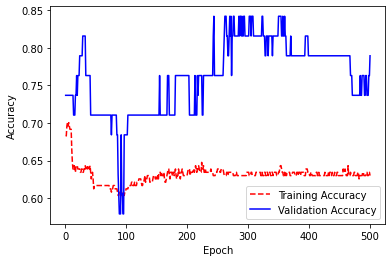

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 19ms/step - loss: 0.8311 - accuracy: 0.6788 - val_loss: 0.8685 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9646 - accuracy: 0.6977 - val_loss: 0.8673 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9391 - accuracy: 0.6895 - val_loss: 0.8671 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9437 - accuracy: 0.6

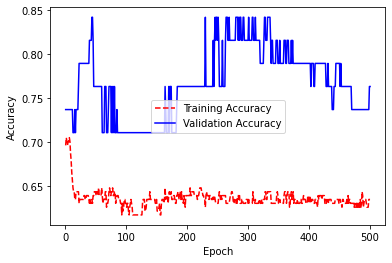

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.8520 - accuracy: 0.6643 - val_loss: 0.7986 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8394 - accuracy: 0.7214 - val_loss: 0.7996 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 8ms/step - loss: 0.8244 - accuracy: 0.6961 - val_loss: 0.7994 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8034 - accuracy: 0.6

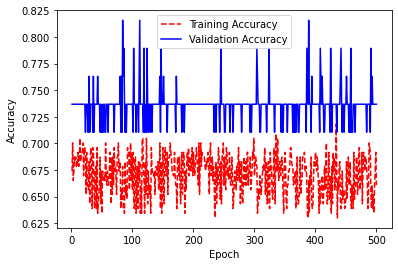

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8987 - accuracy: 0.6333 - val_loss: 0.7953 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8478 - accuracy: 0.6845 - val_loss: 0.7993 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8432 - accuracy: 0.6143 - val_loss: 0.7989 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8598 - accuracy: 0.6

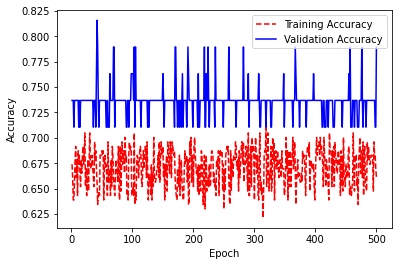

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 19ms/step - loss: 0.8024 - accuracy: 0.7295 - val_loss: 0.7862 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9100 - accuracy: 0.6512 - val_loss: 0.7862 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 1s 37ms/step - loss: 0.8080 - accuracy: 0.7090 - val_loss: 0.7863 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8823 - accuracy: 0.

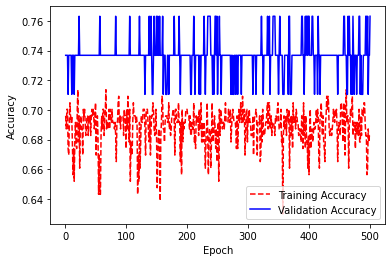

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.8895 - accuracy: 0.7125 - val_loss: 0.7847 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8893 - accuracy: 0.6542 - val_loss: 0.7845 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8701 - accuracy: 0.6804 - val_loss: 0.7845 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 8ms/step - loss: 0.8188 - accuracy: 0.6

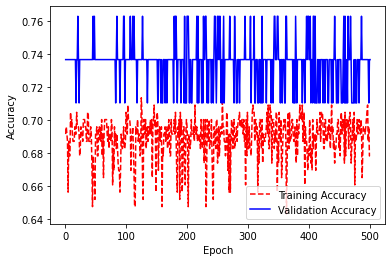

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.8594 - accuracy: 0.6353 - val_loss: 0.7617 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7934 - accuracy: 0.7234 - val_loss: 0.8110 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8336 - accuracy: 0.6943 - val_loss: 0.7676 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8313 - accuracy: 0.6

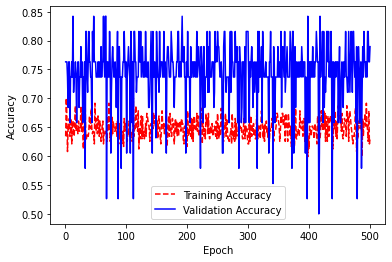

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 1.0000 - accuracy: 0.4445 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4274 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4625 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 9ms/step - loss: 1.0000 - accuracy: 0.4

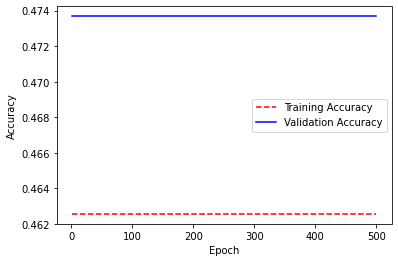

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 23ms/step - loss: 0.8236 - accuracy: 0.6621 - val_loss: 0.8036 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8491 - accuracy: 0.6183 - val_loss: 0.8234 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9219 - accuracy: 0.6735 - val_loss: 0.7935 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8122 - accuracy: 0.6

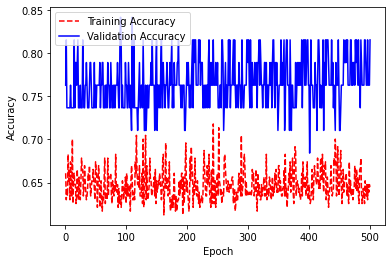

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 24ms/step - loss: 1.0000 - accuracy: 0.4809 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4663 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4599 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

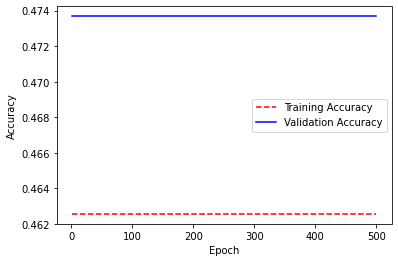

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.7961 - accuracy: 0.6155 - val_loss: 0.5833 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8329 - accuracy: 0.6004 - val_loss: 0.5810 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.7679 - accuracy: 0.6432 - val_loss: 0.5824 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7614 - accuracy: 0.6

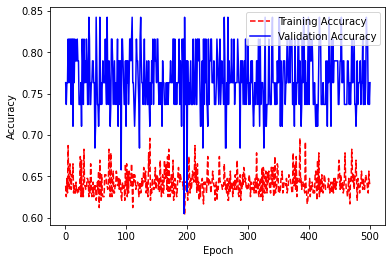

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.7539 - accuracy: 0.6296 - val_loss: 0.6286 - val_accuracy: 0.6579
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8275 - accuracy: 0.6003 - val_loss: 0.6107 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7460 - accuracy: 0.6383 - val_loss: 0.5833 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7826 - accuracy: 0.6

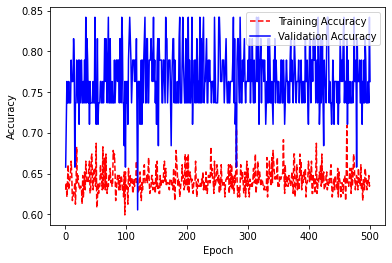

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.7553 - accuracy: 0.6166 - val_loss: 0.5690 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7126 - accuracy: 0.6724 - val_loss: 0.5797 - val_accuracy: 0.7105
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7783 - accuracy: 0.6236 - val_loss: 0.5687 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7105 - accuracy: 0.6

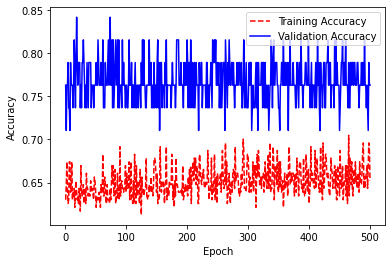

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 27ms/step - loss: 0.6912 - accuracy: 0.6520 - val_loss: 0.5592 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7437 - accuracy: 0.6178 - val_loss: 0.5553 - val_accuracy: 0.8158
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7631 - accuracy: 0.5982 - val_loss: 0.5753 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7069 - accuracy: 0.6

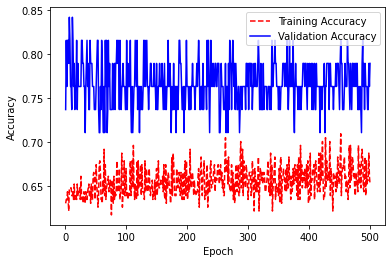

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8993 - accuracy: 0.6545 - val_loss: 0.7984 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8134 - accuracy: 0.6814 - val_loss: 0.7977 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 8ms/step - loss: 0.8494 - accuracy: 0.6860 - val_loss: 0.7972 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8550 - accuracy: 0.6

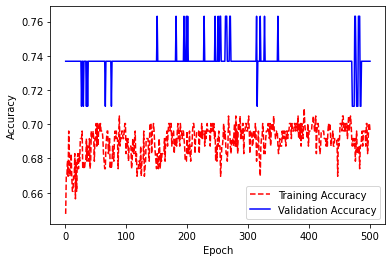

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8703 - accuracy: 0.6218 - val_loss: 0.7988 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8759 - accuracy: 0.6398 - val_loss: 0.7975 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8847 - accuracy: 0.6259 - val_loss: 0.7962 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8616 - accuracy: 0.6

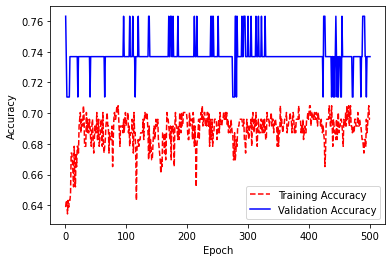

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.8557 - accuracy: 0.6826 - val_loss: 0.7839 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8677 - accuracy: 0.6831 - val_loss: 0.7833 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8135 - accuracy: 0.7288 - val_loss: 0.7833 - val_accuracy: 0.7105
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8428 - accuracy: 0.7

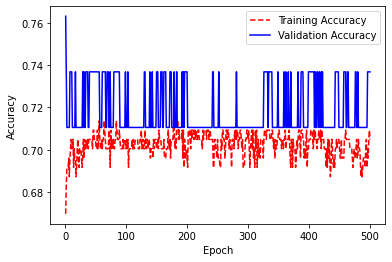

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 25ms/step - loss: 0.8532 - accuracy: 0.7148 - val_loss: 0.7827 - val_accuracy: 0.7368
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8438 - accuracy: 0.6998 - val_loss: 0.7825 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8522 - accuracy: 0.6668 - val_loss: 0.7825 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 9ms/step - loss: 0.8720 - accuracy: 0.6

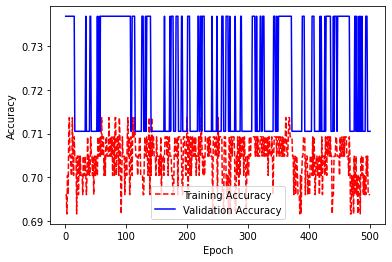

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 2s 62ms/step - loss: 0.8770 - accuracy: 0.6619 - val_loss: 0.7684 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8288 - accuracy: 0.6240 - val_loss: 0.7592 - val_accuracy: 0.7368
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7821 - accuracy: 0.6705 - val_loss: 0.7671 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8872 - accuracy: 0.6

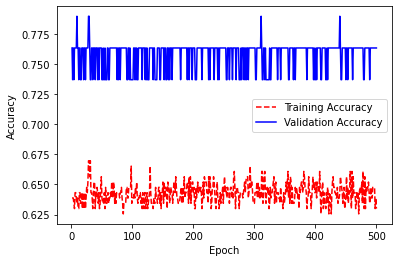

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 1.0000 - accuracy: 0.4308 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0000 - accuracy: 0.4806 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0000 - accuracy: 0.4542 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0000 - accuracy: 0.4

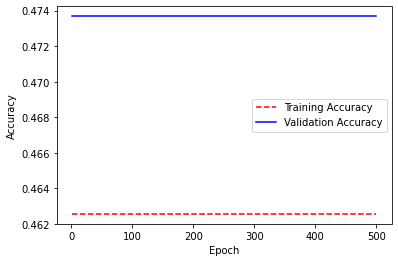

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_30 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.8984 - accuracy: 0.5980 - val_loss: 0.7920 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8953 - accuracy: 0.6107 - val_loss: 0.7831 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8759 - accuracy: 0.6696 - val_loss: 0.7799 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8489 - accuracy: 0.6

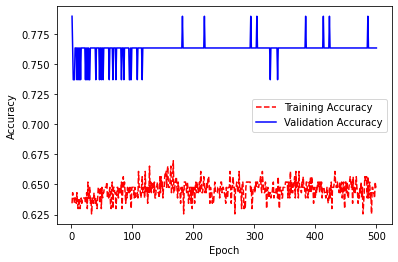

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 1.0001 - accuracy: 0.4972 - val_loss: 1.0003 - val_accuracy: 0.4737
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0002 - accuracy: 0.4527 - val_loss: 1.0000 - val_accuracy: 0.4737
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0001 - accuracy: 0.4633 - val_loss: 1.0003 - val_accuracy: 0.4737
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0002 - accuracy: 0.4

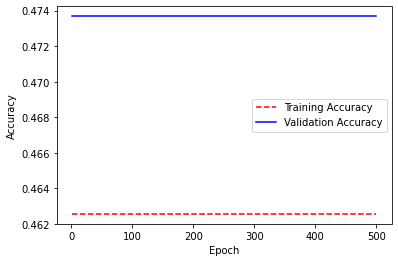

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.7400 - accuracy: 0.6952 - val_loss: 0.5778 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7415 - accuracy: 0.6309 - val_loss: 0.5758 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7430 - accuracy: 0.6595 - val_loss: 0.5734 - val_accuracy: 0.7368
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.7137 - accuracy: 0.6

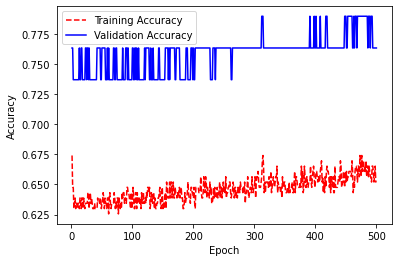

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 21ms/step - loss: 0.7400 - accuracy: 0.6695 - val_loss: 0.5767 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7801 - accuracy: 0.6470 - val_loss: 0.5762 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.7721 - accuracy: 0.6219 - val_loss: 0.5755 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7757 - accuracy: 0.6

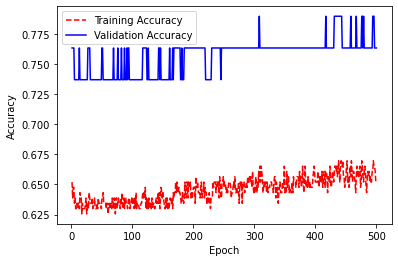

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 20ms/step - loss: 0.7304 - accuracy: 0.6310 - val_loss: 0.5472 - val_accuracy: 0.7632
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7347 - accuracy: 0.6421 - val_loss: 0.5493 - val_accuracy: 0.7632
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.7290 - accuracy: 0.6415 - val_loss: 0.5500 - val_accuracy: 0.7632
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6705 - accuracy: 0.6

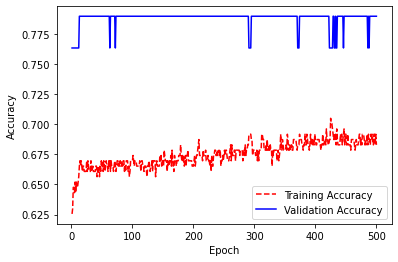

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 22ms/step - loss: 0.7660 - accuracy: 0.6391 - val_loss: 0.5591 - val_accuracy: 0.7895
Epoch 2/500
15/15 [==============================] - 0s 7ms/step - loss: 0.7073 - accuracy: 0.6622 - val_loss: 0.5579 - val_accuracy: 0.7895
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6631 - accuracy: 0.6922 - val_loss: 0.5580 - val_accuracy: 0.7895
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.7254 - accuracy: 0.6

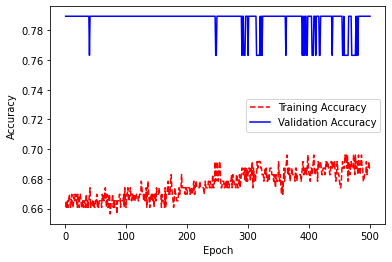

In [30]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [31]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.83
Test fraction correct (NN-Accuracy) = 0.61


**Softmax**

In [19]:
#try different activation functions and regularizers
Possible_activations = ['softmax']
possible_regs = [regularizers.l2(0.01), regularizers.l1(0.01)]
possible_initializers = [RandomNormal(), RandomUniform()]
possible_models = []
for act in Possible_activations:
  for reg in possible_regs:
    for init in possible_initializers:
      my_model = Sequential()
      my_model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=init, kernel_regularizer=reg, bias_regularizer= reg, name= "dense_layer"))
      my_model.add(Dense(units=1, activation=act))
      possible_models.append(my_model)

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6916 - accuracy: 0.5486 - val_loss: 0.6920 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6911 - accuracy: 0.5471 - val_loss: 0.6918 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6925 - accuracy: 0.5150 - val_loss: 0.6915 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6920 - accuracy: 0.52

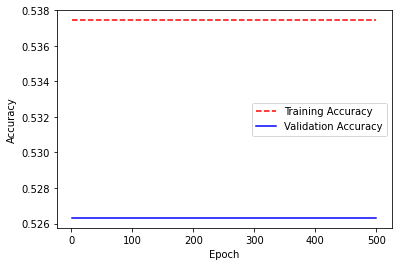

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6913 - accuracy: 0.5497 - val_loss: 0.6890 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6871 - accuracy: 0.5580 - val_loss: 0.6872 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6884 - accuracy: 0.5261 - val_loss: 0.6862 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6904 - accuracy: 0.50

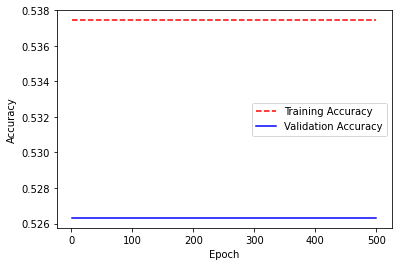

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.7038 - accuracy: 0.5431 - val_loss: 0.6940 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6932 - accuracy: 0.5271 - val_loss: 0.6917 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6911 - accuracy: 0.5325 - val_loss: 0.6908 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6863 - accuracy: 0.5

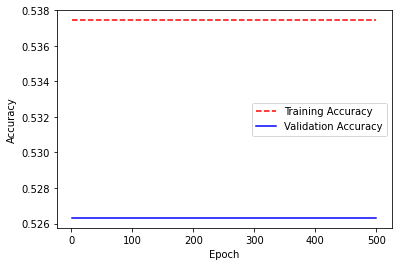

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6967 - accuracy: 0.5641 - val_loss: 0.6938 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6939 - accuracy: 0.5133 - val_loss: 0.6930 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6920 - accuracy: 0.5626 - val_loss: 0.6926 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6915 - accuracy: 0.5

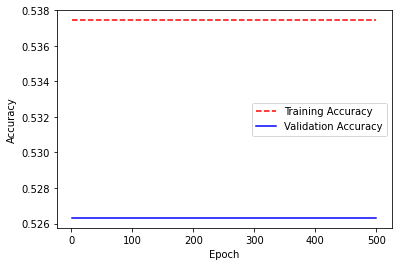

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6432 - accuracy: 0.5719 - val_loss: 0.5711 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6426 - accuracy: 0.5286 - val_loss: 0.5711 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6287 - accuracy: 0.5764 - val_loss: 0.5718 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6571 - accuracy: 0.52

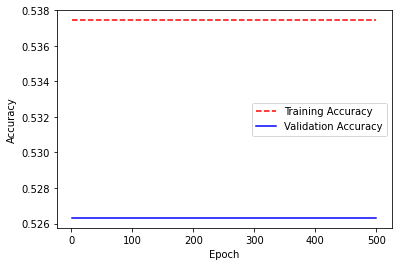

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6342 - accuracy: 0.5021 - val_loss: 0.5575 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6187 - accuracy: 0.5384 - val_loss: 0.5574 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6279 - accuracy: 0.5451 - val_loss: 0.5595 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6295 - accuracy: 0.51

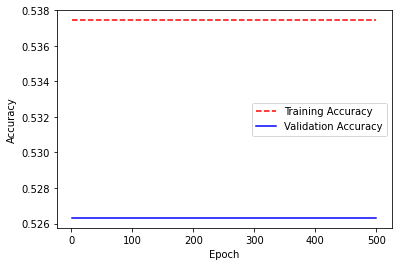

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6235 - accuracy: 0.5287 - val_loss: 0.5569 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6511 - accuracy: 0.5081 - val_loss: 0.5593 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6418 - accuracy: 0.5248 - val_loss: 0.5567 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6447 - accuracy: 0.5

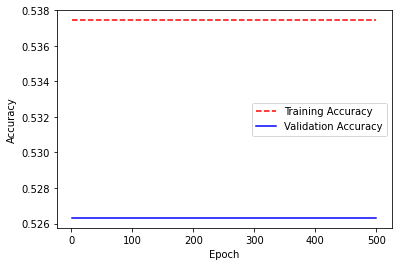

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6894 - accuracy: 0.5442 - val_loss: 0.6920 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6899 - accuracy: 0.5410 - val_loss: 0.6919 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6879 - accuracy: 0.5553 - val_loss: 0.6919 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6954 - accuracy: 0.5

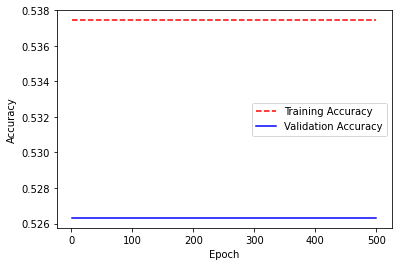

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6397 - accuracy: 0.5382 - val_loss: 0.5649 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6307 - accuracy: 0.5202 - val_loss: 0.5647 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6147 - accuracy: 0.5241 - val_loss: 0.5645 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.6323 - accuracy: 0.51

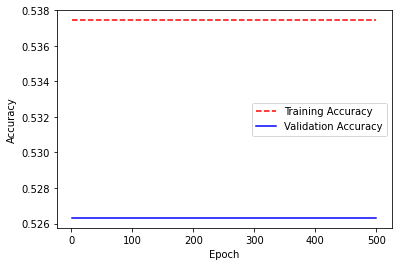

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6726 - accuracy: 0.5364 - val_loss: 0.5567 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6199 - accuracy: 0.5744 - val_loss: 0.5565 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6532 - accuracy: 0.4832 - val_loss: 0.5561 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6235 - accuracy: 0.51

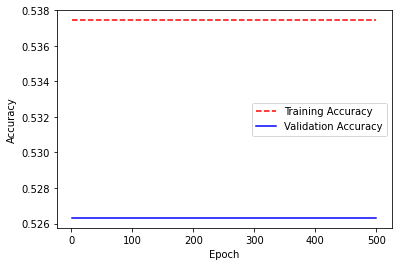

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 16ms/step - loss: 0.6428 - accuracy: 0.5569 - val_loss: 0.5522 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6165 - accuracy: 0.5399 - val_loss: 0.5523 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6541 - accuracy: 0.5332 - val_loss: 0.5523 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.5854 - accuracy: 0.5

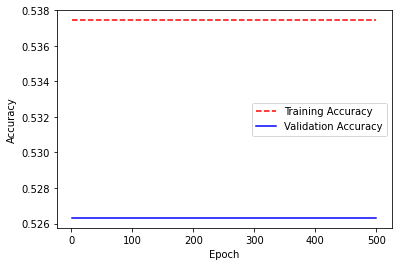

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.6927 - accuracy: 0.5240 - val_loss: 0.6922 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 5ms/step - loss: 0.6870 - accuracy: 0.5609 - val_loss: 0.6921 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6849 - accuracy: 0.5742 - val_loss: 0.6922 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.6820 - accuracy: 0.5

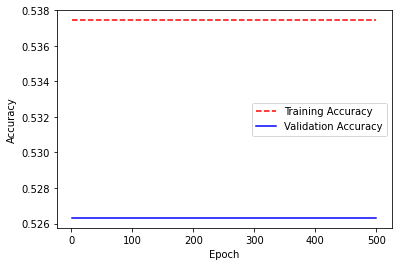

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9089 - accuracy: 0.5515 - val_loss: 0.9593 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9555 - accuracy: 0.5282 - val_loss: 0.9593 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9111 - accuracy: 0.5504 - val_loss: 0.9592 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9716 - accuracy: 0.52

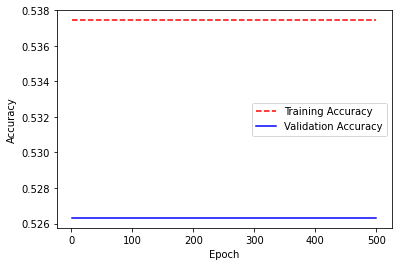

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.9571 - accuracy: 0.5270 - val_loss: 0.9584 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9115 - accuracy: 0.5498 - val_loss: 0.9584 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 1.0127 - accuracy: 0.4991 - val_loss: 0.9583 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9049 - accuracy: 0.55

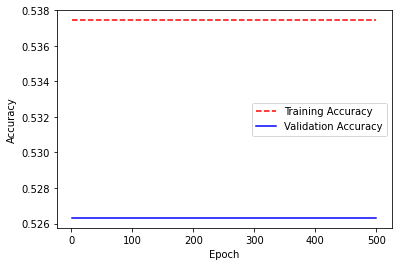

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9056 - accuracy: 0.5567 - val_loss: 0.9663 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8510 - accuracy: 0.5840 - val_loss: 0.9663 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0086 - accuracy: 0.5051 - val_loss: 0.9662 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9795 - accuracy: 0.5

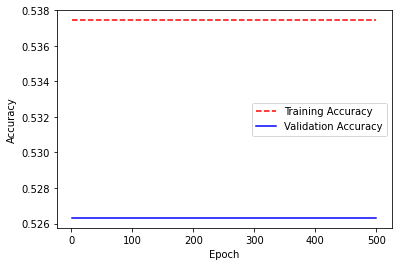

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.8137 - accuracy: 0.5932 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9543 - accuracy: 0.5229 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9777 - accuracy: 0.5112 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0088 - accuracy: 0.4

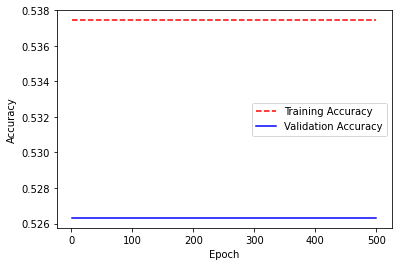

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 19ms/step - loss: 0.8814 - accuracy: 0.5593 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8512 - accuracy: 0.5744 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.9602 - accuracy: 0.5199 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0000 - accuracy: 0.50

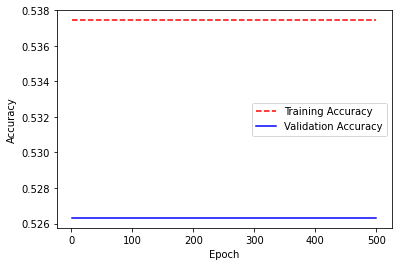

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.9289 - accuracy: 0.5356 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9799 - accuracy: 0.5101 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9175 - accuracy: 0.5413 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9747 - accuracy: 0.51

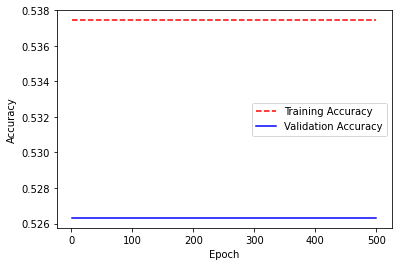

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.8971 - accuracy: 0.5515 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9451 - accuracy: 0.5274 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9781 - accuracy: 0.5110 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 5ms/step - loss: 0.9258 - accuracy: 0.5

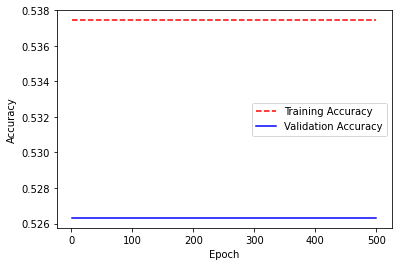

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 19ms/step - loss: 0.8148 - accuracy: 0.5926 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8722 - accuracy: 0.5639 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9330 - accuracy: 0.5335 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9255 - accuracy: 0.5

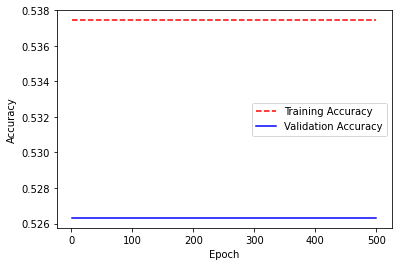

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.9028 - accuracy: 0.5486 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8859 - accuracy: 0.5570 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.9253 - accuracy: 0.5374 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8878 - accuracy: 0.55

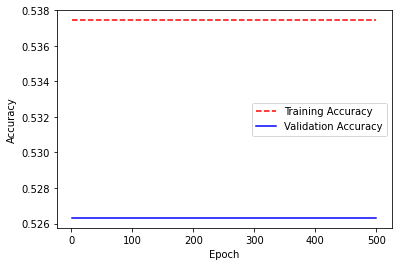

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.9284 - accuracy: 0.5358 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.8993 - accuracy: 0.5504 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9112 - accuracy: 0.5444 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 0.8657 - accuracy: 0.56

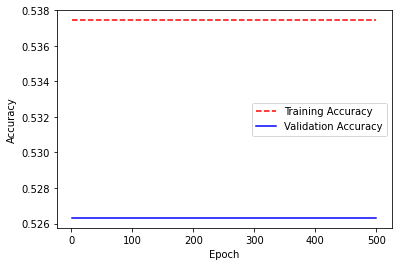

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 18ms/step - loss: 0.8041 - accuracy: 0.5980 - val_loss: 0.9476 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9525 - accuracy: 0.5238 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 5ms/step - loss: 0.8757 - accuracy: 0.5622 - val_loss: 0.9476 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 7ms/step - loss: 1.0300 - accuracy: 0.4

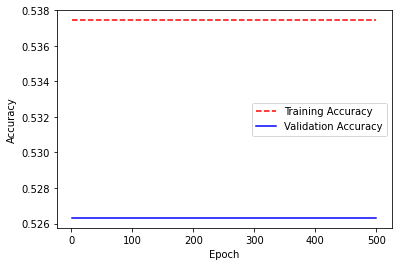

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_layer (Dense)          (None, 1)                 27        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 2         
Total params: 29
Trainable params: 29
Non-trainable params: 0
_________________________________________________________________
Epoch 1/500
15/15 [==============================] - 1s 17ms/step - loss: 0.9452 - accuracy: 0.5275 - val_loss: 0.9476 - val_accuracy: 0.5263
Epoch 2/500
15/15 [==============================] - 0s 6ms/step - loss: 0.9761 - accuracy: 0.5120 - val_loss: 0.9474 - val_accuracy: 0.5263
Epoch 3/500
15/15 [==============================] - 0s 7ms/step - loss: 0.9373 - accuracy: 0.5314 - val_loss: 0.9476 - val_accuracy: 0.5263
Epoch 4/500
15/15 [==============================] - 0s 6ms/step - loss: 1.0294 - accuracy: 0.4

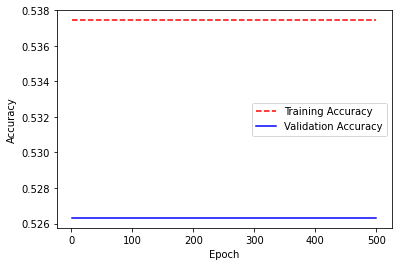

In [20]:
#try different loss functions and optimizers
possible_loss = [BinaryCrossentropy(), CategoricalHinge()]
possible_optimizers = [Adam(), SGD(), RMSprop()]
best_model = possible_models[0]
best_test_acc = 0
for loss in possible_loss:
  for opt in possible_optimizers:
    for model in possible_models:
      model.compile(loss=loss, metrics=['accuracy'], optimizer=opt)
      model.summary()
      hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)
      score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
      print("Test fraction correct (NN-Score) = {:.2f}".format(score))
      print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))
      if (accuracy > best_test_acc):
        best_test_acc = accuracy
        best_model = model
      # Get training and test loss histories
      training_loss = hist.history['accuracy']
      val_loss = hist.history['val_accuracy']

      # Create count of the number of epochs
      epoch_count = range(1, len(training_loss) + 1)

      # Visualize loss history
      plt.figure()
      plt.plot(epoch_count, training_loss, 'r--')
      plt.plot(epoch_count, val_loss, 'b-')
      plt.legend(['Training Accuracy', 'Validation Accuracy'])
      plt.xlabel('Epoch')
      plt.ylabel('Accuracy')
      plt.show()

In [21]:
score, accuracy = best_model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

Test fraction correct (NN-Score) = 0.79
Test fraction correct (NN-Accuracy) = 0.61


# Original Code

In [ ]:
activation = 'sigmoid'
regularizer = regularizers.l2(0.01)

# TODO: Define the Model using Tensorflow.Keras
model = Sequential()
model.add(Dense(units=1, activation='linear', input_shape= (train_X.shape[1],), kernel_initializer=RandomNorm(), kernel_regularizer=regularizer, bias_regularizer= regularizer, name= "dense_layer"))
model.add(Dense(units=1, activation=activation))

### 1.2.2.4 Compile your model and print a summary

**TODO**
1. Try different losses functions and include in the report their effect on the accuracy. Make sure that those losses functions are meant only for classification! Don't use losses functions that are meant for prediction!
2. Try different optimizers and include in the report their effect on the accuracy and the training plot.

In [ ]:
## TODO Try Different losses & optimizers here
model.compile(loss=BinaryCrossentropy(), metrics=['accuracy'], optimizer=Adam())
model.summary()

### 1.2.2.5 Train your model

In [ ]:
hist = model.fit(train_X, train_y, verbose=1, validation_data=(val_X, val_y), batch_size=16, epochs=500)

Evaluate your testing split, to get the accuracy and the loss score.

In [ ]:
score, accuracy = model.evaluate(test_X, test_y, batch_size=16, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

### 1.2.2.6 Visualize Accuracy

Plot the training and validation accuracy. Try to interpret those plots. 


**TODO: for each experiment you make, include this plot and indicate whether there exist any type of overfitting or underfitting.**

In [ ]:
# Get training and test loss histories
training_loss = hist.history['accuracy']
val_loss = hist.history['val_accuracy']

# Create count of the number of epochs
epoch_count = range(1, len(training_loss) + 1)

# Visualize loss history
plt.figure()
plt.plot(epoch_count, training_loss, 'r--')
plt.plot(epoch_count, val_loss, 'b-')
plt.legend(['Training Accuracy', 'Validation Accuracy'])
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.show()

## 1.2.3 Conclusion

That's it! Congratulations on training a logistic regression model.

Make sure you deliver all the requirements for the submission.